# ATTENTİON MEKANİZMASI

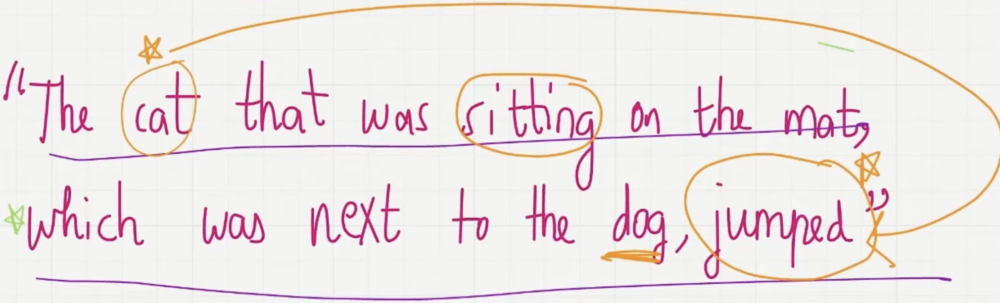


Basitce model her çıktıyı üretirken girişin hangi kısmına dikkat etmesi gerektiğini öğrenir.

Bilginin kelimeler arasında akmasını sağlar.

Bağlamı korur.

Modelin “hangi bilgi önemli?” sorusuna dinamik olarak cevap vermesini sağlar.

Attention mekainizma temelde 4 tipdir.

1. Basitleştirilmiş Attention mekanizması
Ana fikri vermek için inceleyeceğiz.
2. Self Attetnion Mekanizması
eğitilebilir parametrelerle gerçekleştirilir ve LLM'lerin temelini oluşturur
3. Casual Attention Mekanizması
Sadece önceki ve şimdi girdileri dikkate alan bir attention mekanizması
4. Multihead Attention Mekanizması
Farklı temsil birimlerinden gelen bilgilere aynı anda dikkat etmeyi sağlayan, self-attention ve causal attention’ın bir uzantısıdır.

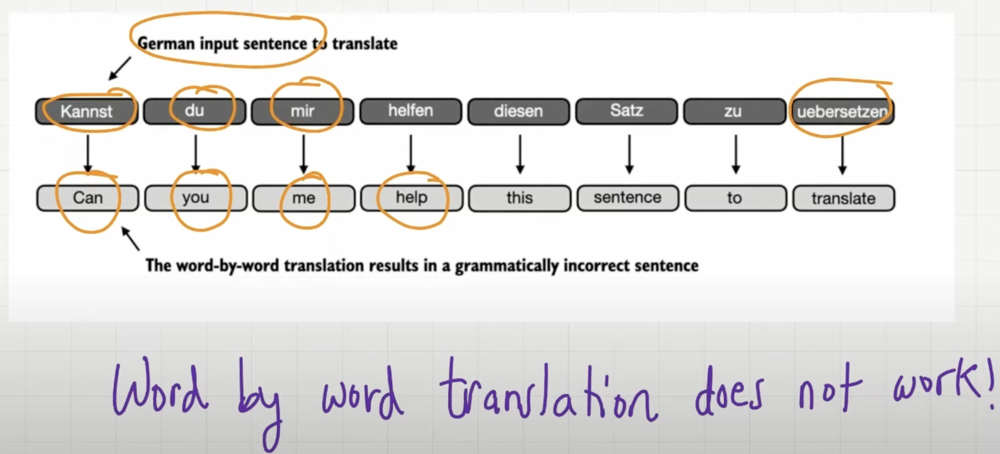

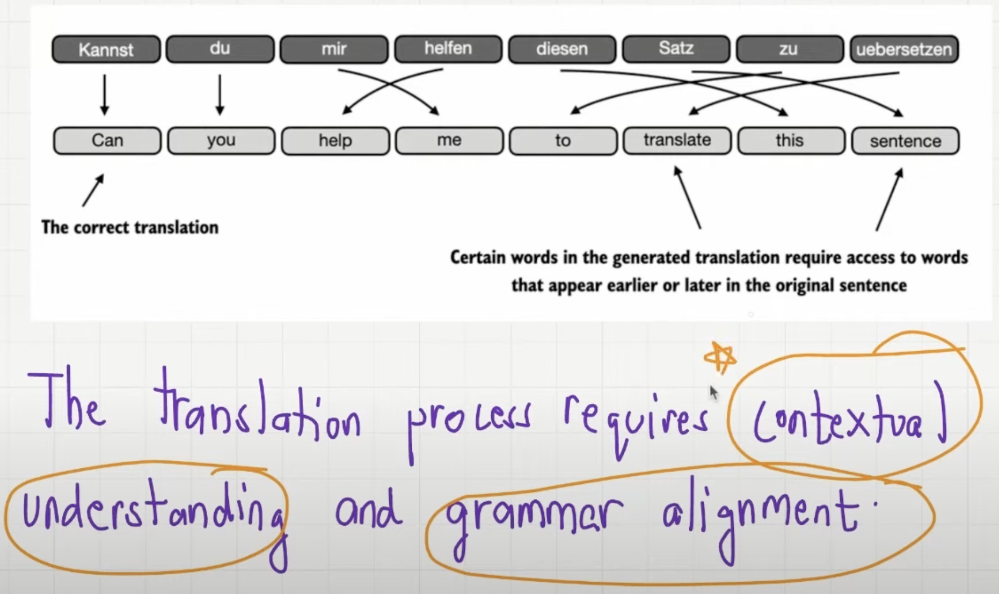

Transformerlardan önce dil modelleri içim RNN'ler (Recurent NeuralNetworks) en popüler encoder-decoder mimarileriydi.
Temelde RRN'ler önceki adımın mevcut adımı beslmesine dayanan bir yaklaşımdır.

RNN ve LSTM modelleri sıralı verilerle (ör. cümleler, zaman serileri) çalışır. Ancak:

- Bilgiyi sabit boyuttaki bir gizli duruma sıkıştırır.
- Uzun dizilerde önceki kelimeleri unutulabilir (vanishing gradient problemi).
- Sabit uzunlukta bağlam vektörü, girişin tüm semantik bilgisini yakalamakta yetersiz kalır.

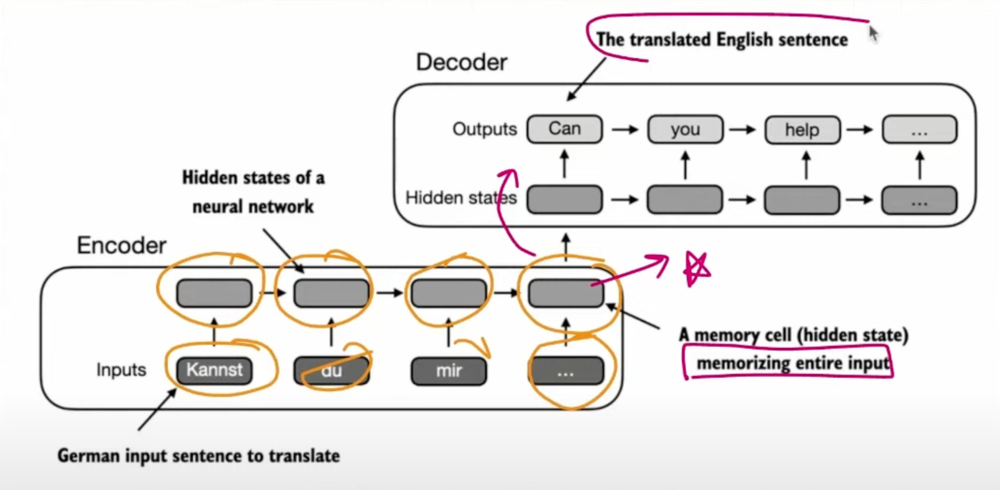

En basit haliyle encoder-decoder çifti ve gizli katmanlar.

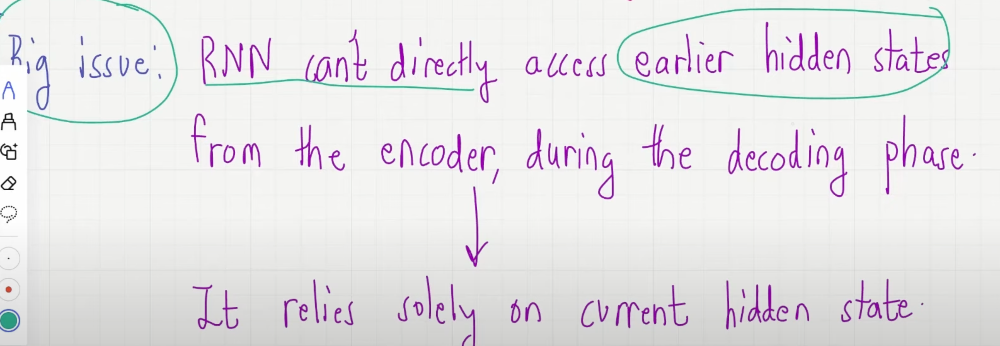

RNN'ler decoding sürecinde doğrudan encoderden önceki gizli katmanlara erişemezler. Yani sadece mevcut gizli katmana bağlı kalırlar. Bu da tabi özelikle karmaşık cümlelerde konteksin ciddi bir şekilde kaybolmasına neden olur. Çünkü bu cümlelerde bağlılıklar uzun mesafelere dayanır.

Bu durumu aşağıdaki linkteki animasyonları ve açıklamaları inceleyerek daha iyi öğrenelim.

[Attention Mekanizması Animasyon](https://jalammar.github.io/visualizing-neural-machine-translation-mechanics-of-seq2seq-models-with-attention/)

Aslında bunun nedeni yukarıda belirrtiğimiz gibi encodere bağlıdır çünkü encoder tüm giriş dizisini sadece bir gizli vectöre dönüştürür. Eğer cümlemiz çok uzunsa kaçınılmaz son ortayaçıkar ve RNN tek bir vektörde tüm bilgiyi yakalayamaz.

İşte bu nedenle ilerleyen süreclerde veriler arası bağımlılıkları yakalayan dikkat mekanizmasını inceleyeceğiz.

RNN'lerin bu kadar popüler olmasının nedeni neydi peki? Neden transformerlardan önce bir inanılmaz derece ses getirerek yeni bir devri açtılar?

Aslında bu sorunun cevabı basit; RNN'ler kısa cümlelerin çevirisinde çok iyi çalışıyorlardı bu da o zaman için güzel bir gelişmeydi en azından basit chatbot'lar geliştirmek için 😁

**Peki attention mekanizması bize ne sunar?**

Atention mekanizması yukarıdaki animasyonda da görüleceği gibi RNN'nin encoder-decoder çiftini değiştirir. Böylece decoder her decoding aşamasındaki girdi dizisinin farklı parçalarına seçici olarak erişim sağlayabilir.

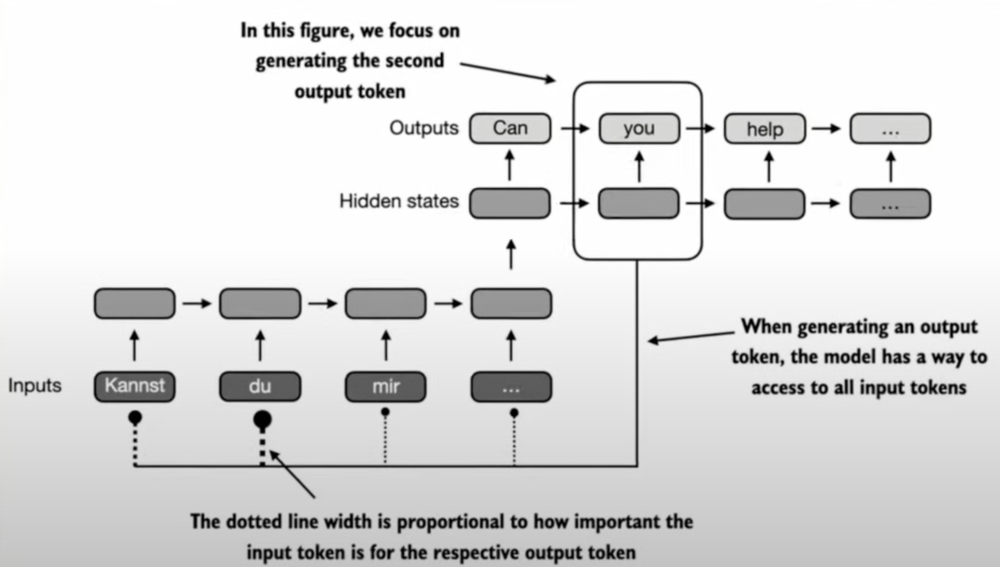

Aslında LLM'lerin kalbini transformer mimarisinin daha gelişmiş bir yapısı olan self-attention mekanizması oluşturur. Fakat ilk olarak trasnformer mimarisi RNN'lerin eksiklerini ve oluşturdukları problemelri ortadan kaldırmak için sunulduğu için önemlidir.

Her decoding aşamasında, model basitce tüm geçmiş giriş dizilerine bakar ve mevcut kelimeyi yaratmak için hangi bölümlerin daha ilgili olduğuna karar verir. Giriş dizesinin farklı bölümleri üzerindeki dinamik fokus modelin uzun menzilli bağımlılıkları daha etkili bir şekilde öğrenmesini sağlar.

**Gelelim Self-Attention mekanizmasına;**

Self-attention bir dizinin gösterimini hesaplarken giriş dizisinin her bir konumunun aynı dizideki tüm konumlara dikkat etmesini sağlayan bir mekanizmadır. Self-attention mekanizması transformer mimarisine dayanan modern LLM'lerin temel bileşeni olup bilinen tüm modellerin (GPT gibi) temelini olulturur.

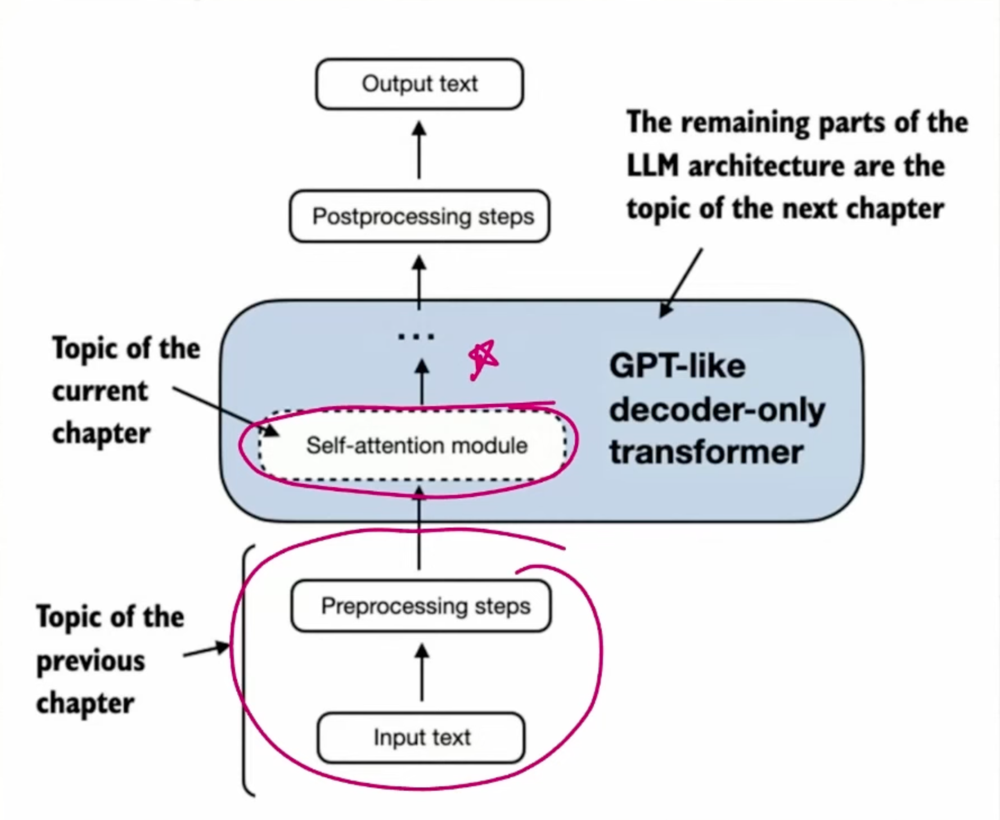

Self-Attention mekanizmasındaki 'self' tek bir girdi dizisinin farklı pozisyonlarıyla ilgili attention weight'lerini hesaplama yeteneğidir
O kendisinin çeşitli girdileri arasındaki ilişkiyi öğrenir. Örneğin bir kelimenin bir cümledeki bağlamı. İşte bu da geleneksel attention mekanizmasından onu ayırır.


## BASİT BİR ATTENTİON MEKANİZMASININ UYGULAMASI

<div class="alert alert-block alert-success">

Aşağıdaki giriş cümlesinin zaten 3 boyutlu vektörlere embed edildiğini varsayalım.

Örneğin sayfaya satır taşması olmadan sığabilmesi için küçük bir embedding boyutu seçiyoruz.

</div>

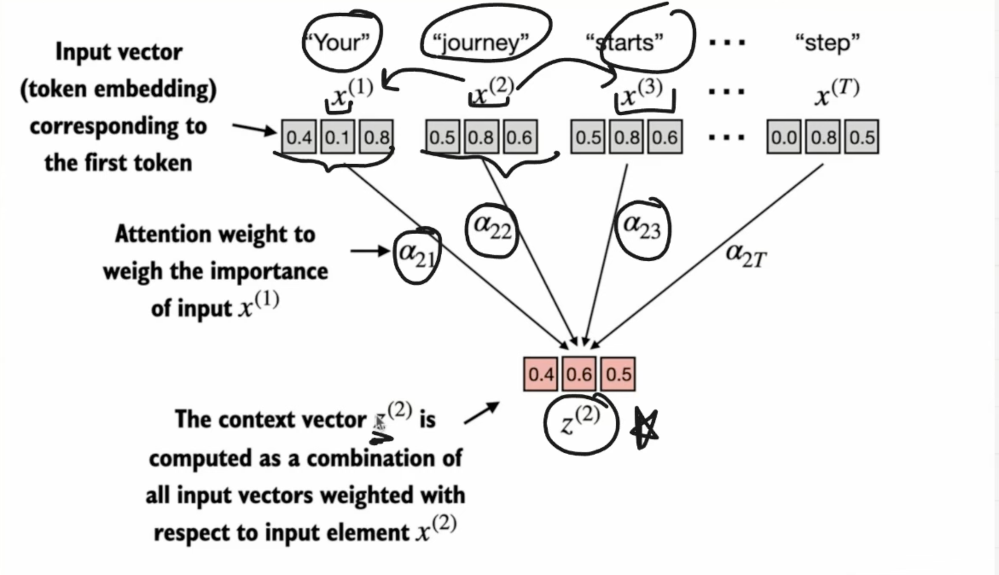

In [14]:
import torch

inputs = torch.tensor(
  [[0.43, 0.15, 0.89], # Your     (x^1)
   [0.55, 0.87, 0.66], # journey  (x^2)
   [0.57, 0.85, 0.64], # starts   (x^3)
   [0.22, 0.58, 0.33], # with     (x^4)
   [0.77, 0.25, 0.10], # one      (x^5)
   [0.05, 0.80, 0.55]] # step     (x^6)
)

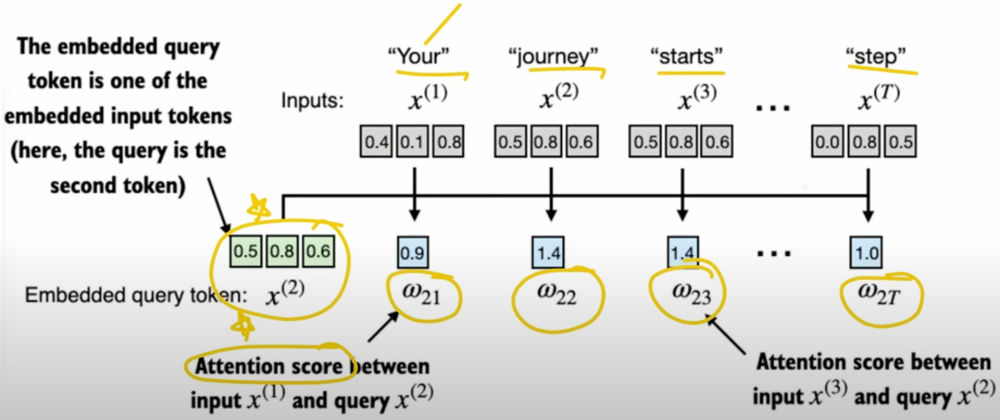

Nokta çarpımını kullanarak benzerliklerini belirleyeceğiz. => |A|.|B|.cos(Q)
Yüksek değer, yüksek benzerlik anlamına gelir ve bu da iki token arasındaki attention skorunu oluşturur.

In [2]:
! pip install matplotlib

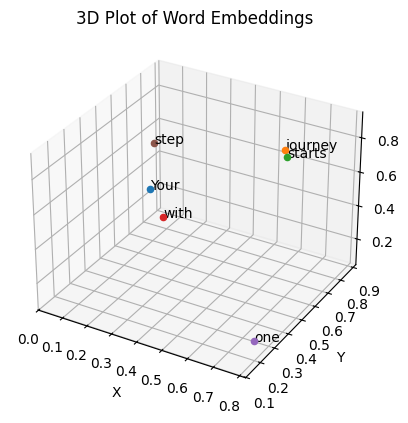

In [3]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Karşılık gelen kelimeler
words = ['Your', 'journey', 'starts', 'with', 'one', 'step']

# X, Y, Z kordinatlarını çıkaralım
x_coords = inputs[:, 0].numpy()
y_coords = inputs[:, 1].numpy()
z_coords = inputs[:, 2].numpy()

# 3D plot oluşturalım
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Her bir noktayı çiz and akarşılık gelen kelimeyle etiketle
for x, y, z, word in zip(x_coords, y_coords, z_coords, words):
    ax.scatter(x, y, z)
    ax.text(x, y, z, word, fontsize=10)

# Kordinatları etiketleyelim
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')

plt.title('3D Plot of Word Embeddings')
plt.show()

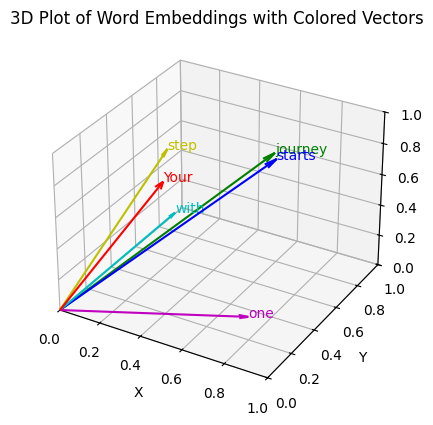

In [4]:
# Farklı renkler kullanarak orijinden noktolara 3D vectorler çizelim 
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Vektörler için bir renk listesi tanımlayın
colors = ['r', 'g', 'b', 'c', 'm', 'y']

# Her vektörü farklı bir renkle çizin ve karşılık gelen kelimeyle not ekleyin
for (x, y, z, word, color) in zip(x_coords, y_coords, z_coords, words, colors):
    # Orijinden (x, y, z) noktasına, belirtilen renkte ve daha küçük ok uzunluk oranıyla vektör çizin
    ax.quiver(0, 0, 0, x, y, z, color=color, arrow_length_ratio=0.05)
    ax.text(x, y, z, word, fontsize=10, color=color)

# Eksenler için etiketler ayarlayın
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')

# Okların grafik sınırları içinde kalması için grafik sınırlarını belirleyin
ax.set_xlim([0, 1])
ax.set_ylim([0, 1])
ax.set_zlim([0, 1])

plt.title('3D Plot of Word Embeddings with Colored Vectors')
plt.show()


<div class="alert alert-block alert-info">
    
Her satır bir kelimeyi temsil eder ve her sütun bir embedding boyutuna karşılık gelir.
    
</div>

<div class="alert alert-block alert-info">
İkinci giriş (input) token'ı, sorgu (query) olarak kullanılır.
</div>

In [5]:
query = inputs[1]  # İkinci giriş tokenı sorgudur.

attn_scores_2 = torch.empty(inputs.shape[0])
for i, x_i in enumerate(inputs):
    attn_scores_2[i] = torch.dot(x_i, query) # kaler çarpım (dot product) — burada transpoze gerekmez çünkü vektörler 1 boyutludur.

print(attn_scores_2)

tensor([0.9544, 1.4950, 1.4754, 0.8434, 0.7070, 1.0865])


<div class="alert alert-block alert-success">

Bir sonraki adımda, önceki adımda hesapladığımız attention skorlarının her birini normalize ederiz.

</div>

<div class="alert alert-block alert-success">

Normalleştirmenin temel amacı, toplamı 1 olan attention ağırlıkları elde etmektir.

Bu normalleştirme, yorumlamayı kolaylaştıran ve büyük dil modeli (LLM) eğitiminde kararlılığı koruyan yaygın bir uygulamadır.

Bu adımı gerçekleştirmek için kullanılan basit ve etkili bir yöntem ise softmax fonksiyonudur:

</div>

In [6]:
attn_weights_2_tmp = attn_scores_2 / attn_scores_2.sum()

print("Attention weights:", attn_weights_2_tmp)
print("Sum:", attn_weights_2_tmp.sum())

Attention weights: tensor([0.1455, 0.2278, 0.2249, 0.1285, 0.1077, 0.1656])
Sum: tensor(1.0000)


<div class="alert alert-block alert-info">
    
Pratikte, normalleştirme için softmax fonksiyonunun kullanılması hem daha yaygın hem de daha tavsiye edilen bir yaklaşımdır.

Bu yöntem, uç (aşırı) değerleri daha iyi yönetir ve eğitim sırasında daha elverişli gradyan (eğim) özellikleri sunar.

Aşağıda, attention skorlarını normalleştirmek için softmax fonksiyonunun basit bir uygulaması yer almaktadır:
</div>

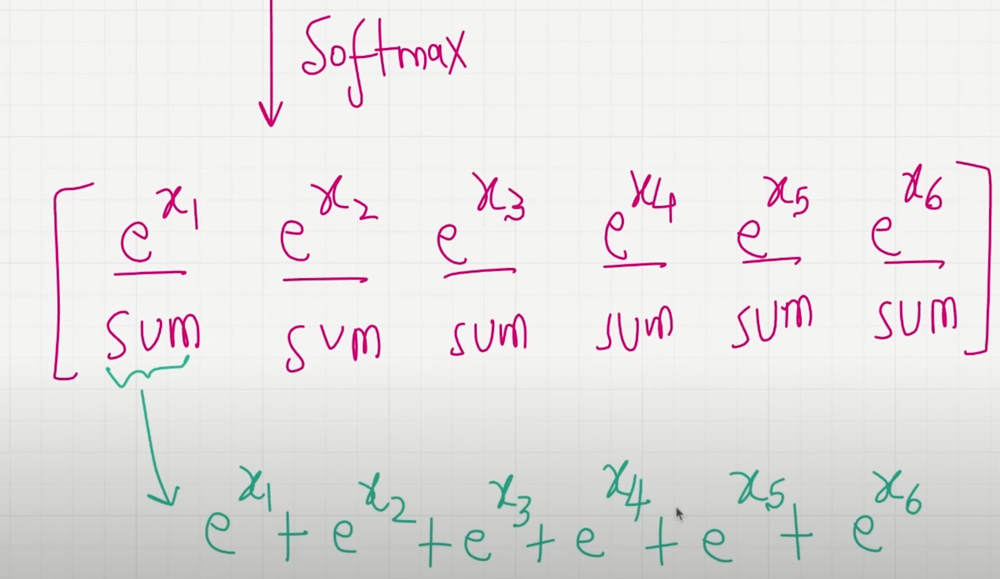

In [7]:
def softmax_naive(x):
    return torch.exp(x) / torch.exp(x).sum(dim=0)

attn_weights_2_naive = softmax_naive(attn_scores_2)

print("Attention weights:", attn_weights_2_naive)
print("Sum:", attn_weights_2_naive.sum())

Attention weights: tensor([0.1385, 0.2379, 0.2333, 0.1240, 0.1082, 0.1581])
Sum: tensor(1.)


<div class="alert alert-block alert-info">
    
Çıktının gösterdiği gibi, softmax fonksiyonu da hedefi karşılar ve attention ağırlıklarını toplamları 1 olacak şekilde normalize eder
</div>

<div class="alert alert-block alert-warning">

Ayrıca, softmax fonksiyonu dikkat (attention) ağırlıklarının her zaman pozitif olmasını sağlar.
Bu da çıktının olasılık veya göreli önem olarak yorumlanabilmesini mümkün kılar;

Yani daha yüksek ağırlıklar, daha büyük önemi gösterir.
    
</div>

<div class="alert alert-block alert-warning">

Şunu unutmayın ki, bu basit softmax uygulaması (softmax_naive) büyük veya küçük girdilerle çalışırken taşma (overflow) ve taşma altı (underflow) gibi sayısal kararsızlık sorunlarıyla karşılaşabilir.

Bu yüzden, pratikte, performans açısından oldukça optimize edilmiş olan PyTorch’un softmax uygulamasını kullanmak daha uygundur:
    
</div>

In [8]:
attn_weights_2 = torch.softmax(attn_scores_2, dim=0)
print("Attention weights:", attn_weights_2)
print("Sum:", attn_weights_2.sum())

Attention weights: tensor([0.1385, 0.2379, 0.2333, 0.1240, 0.1082, 0.1581])
Sum: tensor(1.)


<div class="alert alert-block alert-info">
    
Bu durumda, önceki softmax_naive fonksiyonumuzla aynı sonuçları verdiğini görebiliyoruz:
</div>

<div class="alert alert-block alert-success">

Bağlam vektörü 𝑧(2), tüm giriş vektörlerinin ağırlıklı toplamı olarak hesaplanır.

Bu, her bir giriş vektörünün karşılık gelen dikkat attention ağırlığı ile çarpılmasını içerir:

</div>

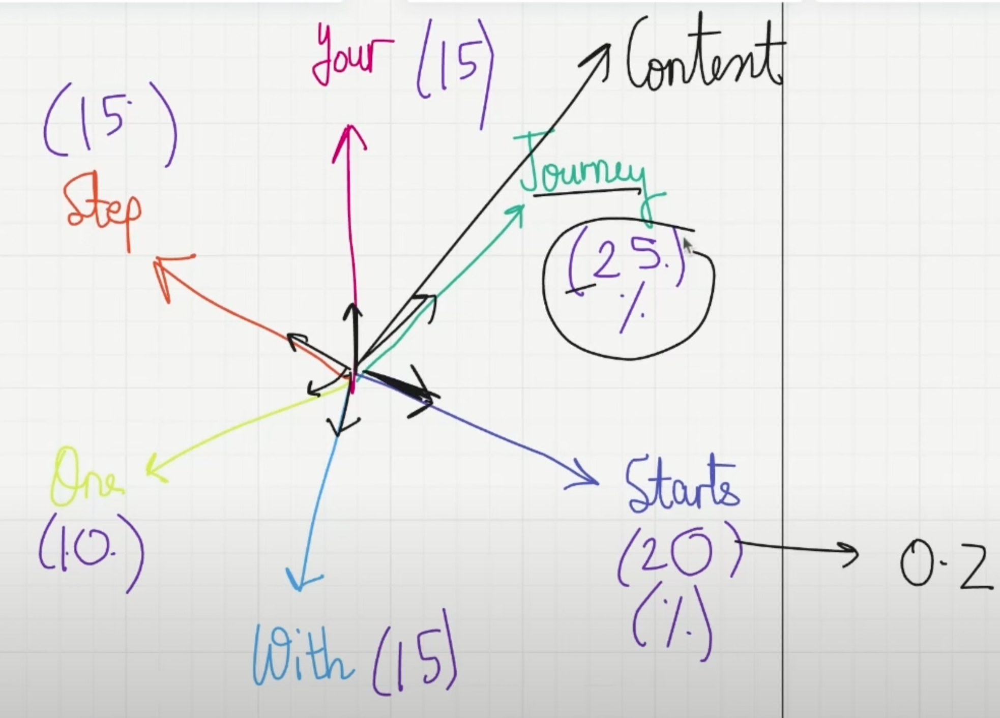

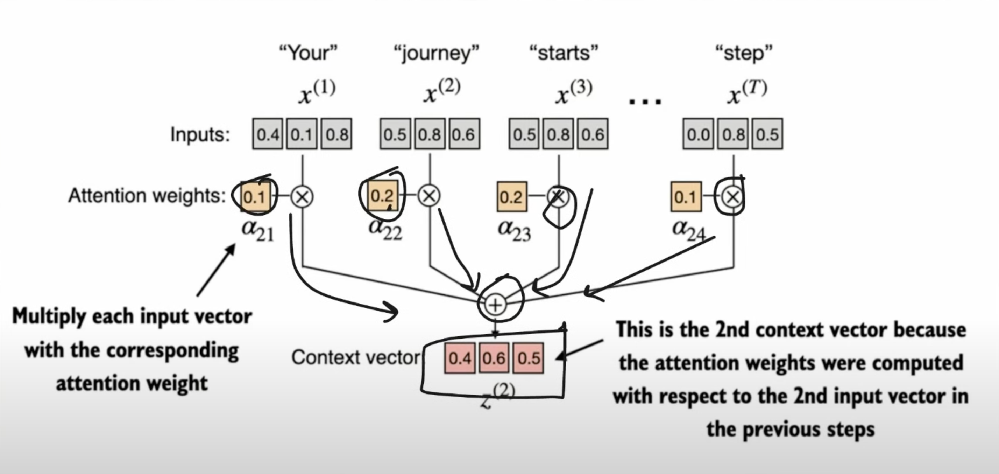

In [9]:
query = inputs[1] # 2. giriş sorgu token)

context_vec_2 = torch.zeros(query.shape)
for i,x_i in enumerate(inputs):
    context_vec_2 += attn_weights_2[i]*x_i

print(context_vec_2)

tensor([0.4419, 0.6515, 0.5683])


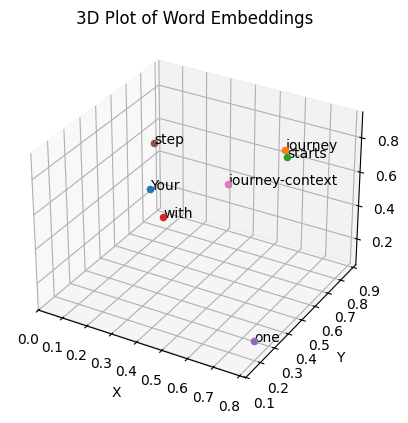

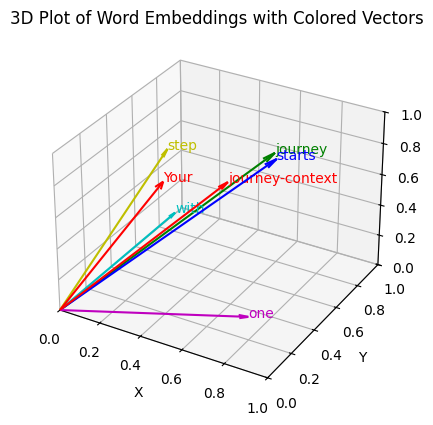

In [18]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

inputs = torch.tensor(
  [[0.43, 0.15, 0.89], # Your     (x^1)
   [0.55, 0.87, 0.66], # journey  (x^2)
   [0.57, 0.85, 0.64], # starts   (x^3)
   [0.22, 0.58, 0.33], # with     (x^4)
   [0.77, 0.25, 0.10], # one      (x^5)
   [0.05, 0.80, 0.55], # step     (x^6)
   [0.4419, 0.6515, 0.5683]]
)

# Karşılık gelen kelimeler
words = ['Your', 'journey', 'starts', 'with', 'one', 'step', 'journey-context']

# x, y, z kordinatlarını çıkaralım
x_coords = inputs[:, 0].numpy()
y_coords = inputs[:, 1].numpy()
z_coords = inputs[:, 2].numpy()

# 3D plot oluşturalım
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Plot each point and annotate with corresponding word
for x, y, z, word in zip(x_coords, y_coords, z_coords, words):
    ax.scatter(x, y, z)
    ax.text(x, y, z, word, fontsize=10)

# Etiketleme
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')

plt.title('3D Plot of Word Embeddings')
plt.show()

# Farklı renkleri kullanarak orijinden her bir noktaya 3 boyutlu vektör çizelim
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Vektörler için bir renk listesi tanımlayalım
colors = ['r', 'g', 'b', 'c', 'm', 'y', 'r']

# Her vektörü farklı bir renkle çizin ve karşılık gelen kelimeyle not ekleyin
for (x, y, z, word, color) in zip(x_coords, y_coords, z_coords, words, colors):
    # Orijinden (x, y, z) noktasına, belirtilen renkte ve daha küçük ok uzunluk oranıyla vektör çizin
    ax.quiver(0, 0, 0, x, y, z, color=color, arrow_length_ratio=0.05)
    ax.text(x, y, z, word, fontsize=10, color=color)

# Etiketleme
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')

# Plot sınırlarını belirleyelim
ax.set_xlim([0, 1])
ax.set_ylim([0, 1])
ax.set_zlim([0, 1])

plt.title('3D Plot of Word Embeddings with Colored Vectors')
plt.show()

<div class="alert alert-block alert-success">

Şimdi, bu hesaplamayı tüm girişler için attention ağırlıkları ve context vektörlerini hesaplayacak şekilde genişletebiliriz.

</div>

<div class="alert alert-block alert-success">

Öncelikle, tüm giriş çiftleri için skaler çarpımları (dot product) hesaplamak amacıyla ek bir for döngüsü ekliyoruz.

</div>

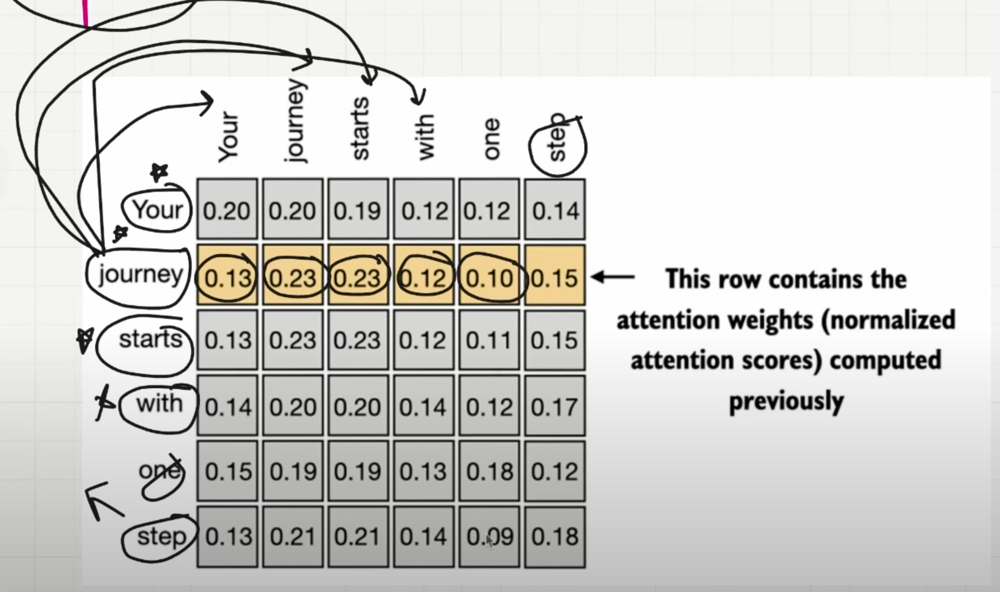

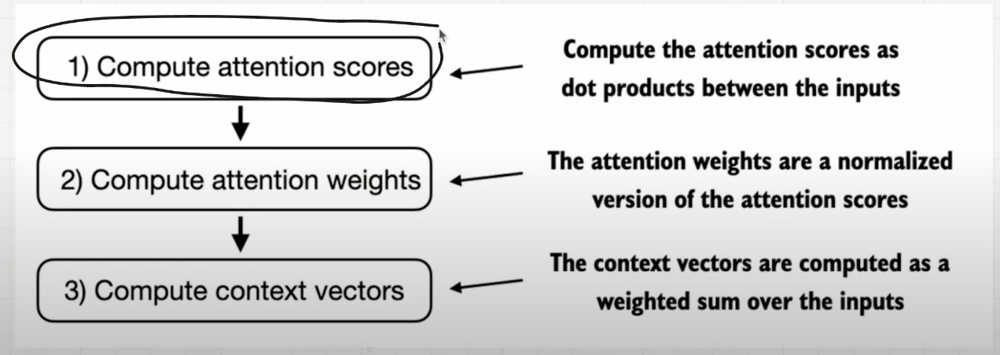

In [15]:
attn_scores = torch.empty(6, 6)

for i, x_i in enumerate(inputs):
    for j, x_j in enumerate(inputs):
        attn_scores[i, j] = torch.dot(x_i, x_j)

print(attn_scores)

tensor([[0.9995, 0.9544, 0.9422, 0.4753, 0.4576, 0.6310],
        [0.9544, 1.4950, 1.4754, 0.8434, 0.7070, 1.0865],
        [0.9422, 1.4754, 1.4570, 0.8296, 0.7154, 1.0605],
        [0.4753, 0.8434, 0.8296, 0.4937, 0.3474, 0.6565],
        [0.4576, 0.7070, 0.7154, 0.3474, 0.6654, 0.2935],
        [0.6310, 1.0865, 1.0605, 0.6565, 0.2935, 0.9450]])


<div class="alert alert-block alert-info">
Önceki tensördeki her bir eleman, her bir giriş çifti arasındaki attention skorunu temsil eder.
</div>

<div class="alert alert-block alert-info">
Önceki attention skoru tensörünü hesaplarken Python'da `for` döngüleri kullandık.

Ancak, `for` döngüleri genellikle yavaştır ve aynı sonuçları matris çarpımı kullanarak çok daha verimli bir şekilde elde edebiliriz:
</div>

In [12]:
attn_scores = inputs @ inputs.T
print(attn_scores)

tensor([[0.9995, 0.9544, 0.9422, 0.4753, 0.4576, 0.6310, 0.7935],
        [0.9544, 1.4950, 1.4754, 0.8434, 0.7070, 1.0865, 1.1849],
        [0.9422, 1.4754, 1.4570, 0.8296, 0.7154, 1.0605, 1.1694],
        [0.4753, 0.8434, 0.8296, 0.4937, 0.3474, 0.6565, 0.6626],
        [0.4576, 0.7070, 0.7154, 0.3474, 0.6654, 0.2935, 0.5600],
        [0.6310, 1.0865, 1.0605, 0.6565, 0.2935, 0.9450, 0.8559],
        [0.7935, 1.1849, 1.1694, 0.6626, 0.5600, 0.8559, 0.9427]])


<div class="alert alert-block alert-success">

Şimdi her satırı normalize ediyoruz, böylece her satırdaki değerlerin toplamı 1 olur:

</div>

In [13]:
attn_weights = torch.softmax(attn_scores, dim=-1)
print(attn_weights)

tensor([[0.1792, 0.1713, 0.1692, 0.1061, 0.1042, 0.1240, 0.1459],
        [0.1180, 0.2026, 0.1986, 0.1056, 0.0921, 0.1346, 0.1486],
        [0.1184, 0.2017, 0.1981, 0.1058, 0.0943, 0.1332, 0.1485],
        [0.1223, 0.1768, 0.1744, 0.1246, 0.1077, 0.1467, 0.1476],
        [0.1305, 0.1675, 0.1689, 0.1169, 0.1607, 0.1108, 0.1446],
        [0.1180, 0.1861, 0.1813, 0.1211, 0.0842, 0.1615, 0.1478],
        [0.1277, 0.1889, 0.1860, 0.1121, 0.1011, 0.1359, 0.1483]])


<div class="alert alert-block alert-warning">

PyTorch kullanırken, dim parametresi, torch.softmax gibi fonksiyonlarda işlemin hangi boyut üzerinde gerçekleştirileceğini belirtir.

dim=-1 olarak ayarlandığında, softmax fonksiyonuna, giriş tensörünün son boyutu boyunca normalizasyon yapması talimatı verilmiş olur.

Eğer attn_scores 2 boyutlu bir tensörse (örneğin, [satırlar, sütunlar] şeklinde), dim=-1 değeri, sütunlar boyunca normalizasyon yapar; yani her satırdaki değerlerin toplamı 1 olur.
    
</div>

<div class="alert alert-block alert-success">

Haydi kısaca satırların gerçekten toplamlarının 1 ettiğinden emin olalım.

</div>

In [16]:
row_2_sum = sum([0.1385, 0.2379, 0.2333, 0.1240, 0.1082, 0.1581])
print("Row 2 sum:", row_2_sum)
print("All row sums:", attn_weights.sum(dim=-1))

Row 2 sum: 1.0
All row sums: tensor([1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000])


<div class="alert alert-block alert-success">

Üçüncü ve son adımda, şimdi bu attention ağırlıklarını kullanarak tüm context vektörlerini matris çarpımı yoluyla hesaplıyoruz.

</div>

In [19]:
all_context_vecs = attn_weights @ inputs
print(all_context_vecs)

tensor([[0.4420, 0.6016, 0.5774],
        [0.4419, 0.6515, 0.5683],
        [0.4429, 0.6499, 0.5673],
        [0.4321, 0.6330, 0.5536],
        [0.4635, 0.5997, 0.5326],
        [0.4213, 0.6505, 0.5651],
        [0.4397, 0.6372, 0.5635]])


<div class="alert alert-block alert-success">

Kodun doğru olduğunu şu şekilde doğrulayabiliriz: 

Daha önce manuel olarak hesapladığımız bağlam vektörü z(2) ile koddan elde edilen 2. satırı karşılaştırarak kontrol edebiliriz. 
Eğer bu iki değer eşleşiyorsa, kodun doğru çalıştığını söyleyebiliriz.

</div>

In [20]:
print("Previous 2nd context vector:", context_vec_2)

Previous 2nd context vector: tensor([0.4419, 0.6515, 0.5683])


<div class="alert alert-block alert-info">
    
Sonuca bakarak, daha önce hesaplanan context_vec_2’nin önceki tensördeki ikinci satırla tamamen eşleştiğini görebiliyoruz.
</div>

<div class="alert alert-block alert-warning">

Evet, basit bir self-attention mekanizmasının kod incelemesini sonuna geldik.
    
</div>

## EĞİTİLEBİLİR PARAMETRELERLE SELF-ATTENTİON MEKAİZMASININ UYGULANMASI

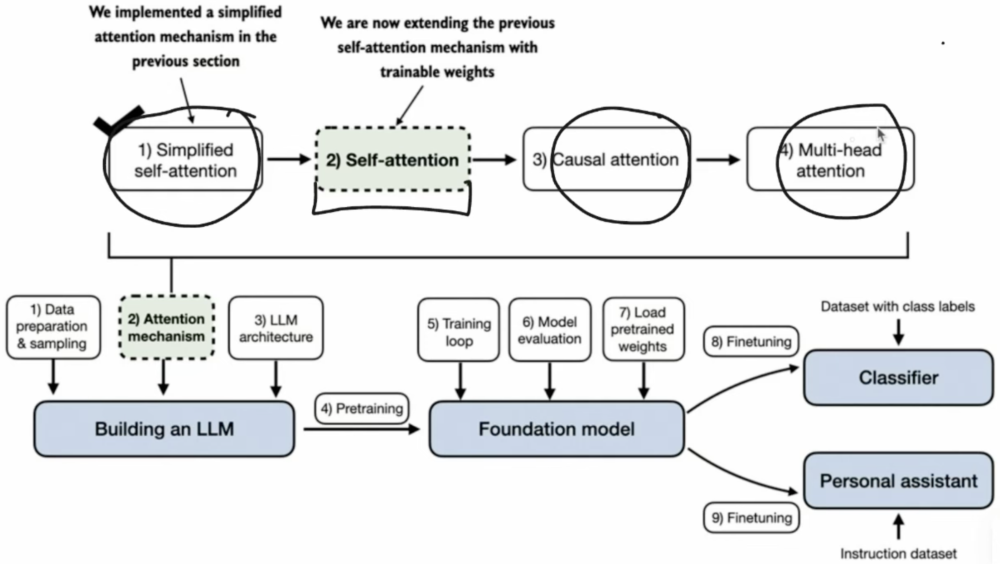

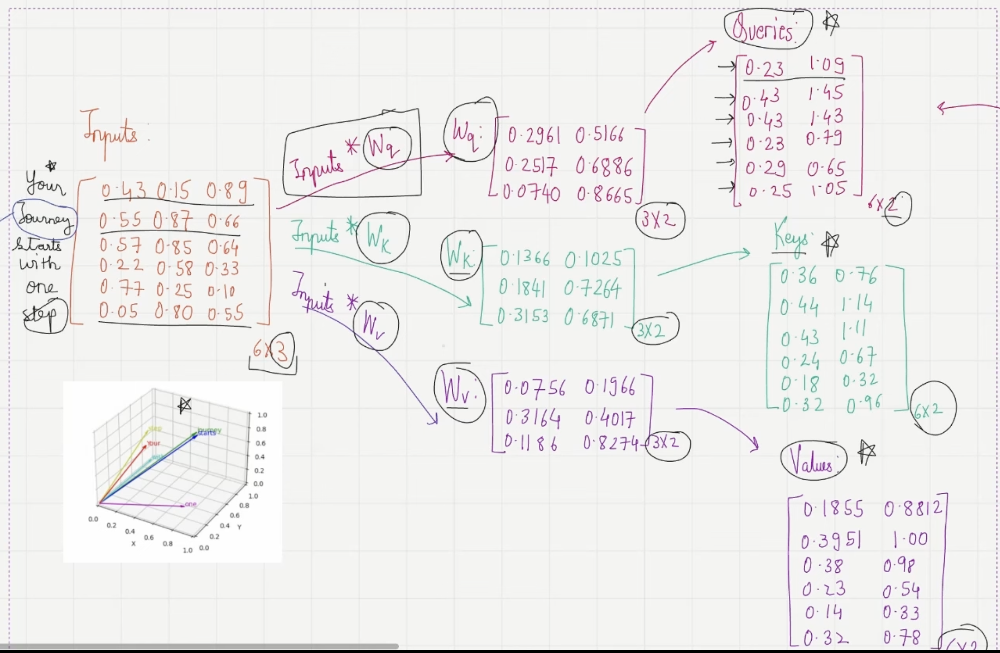

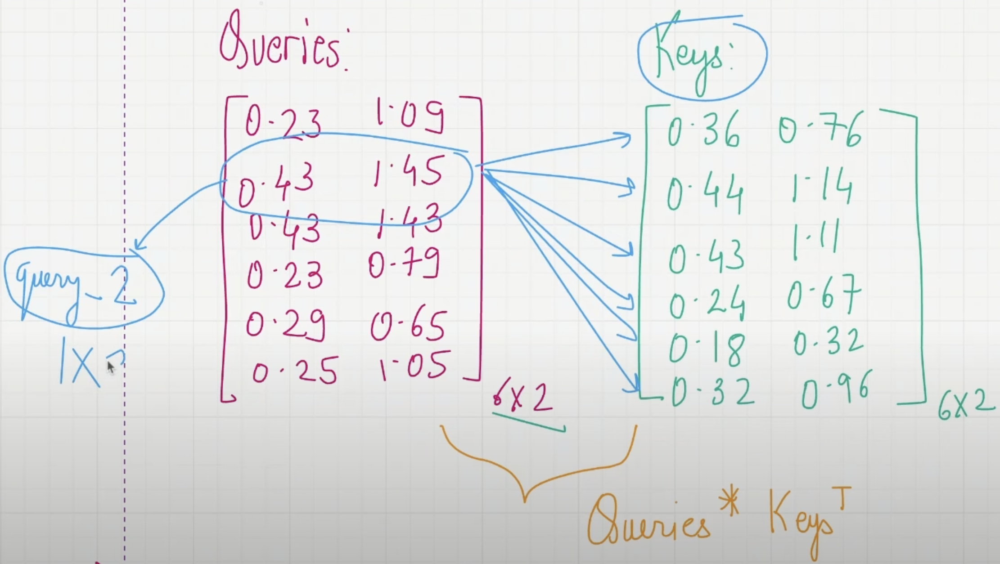

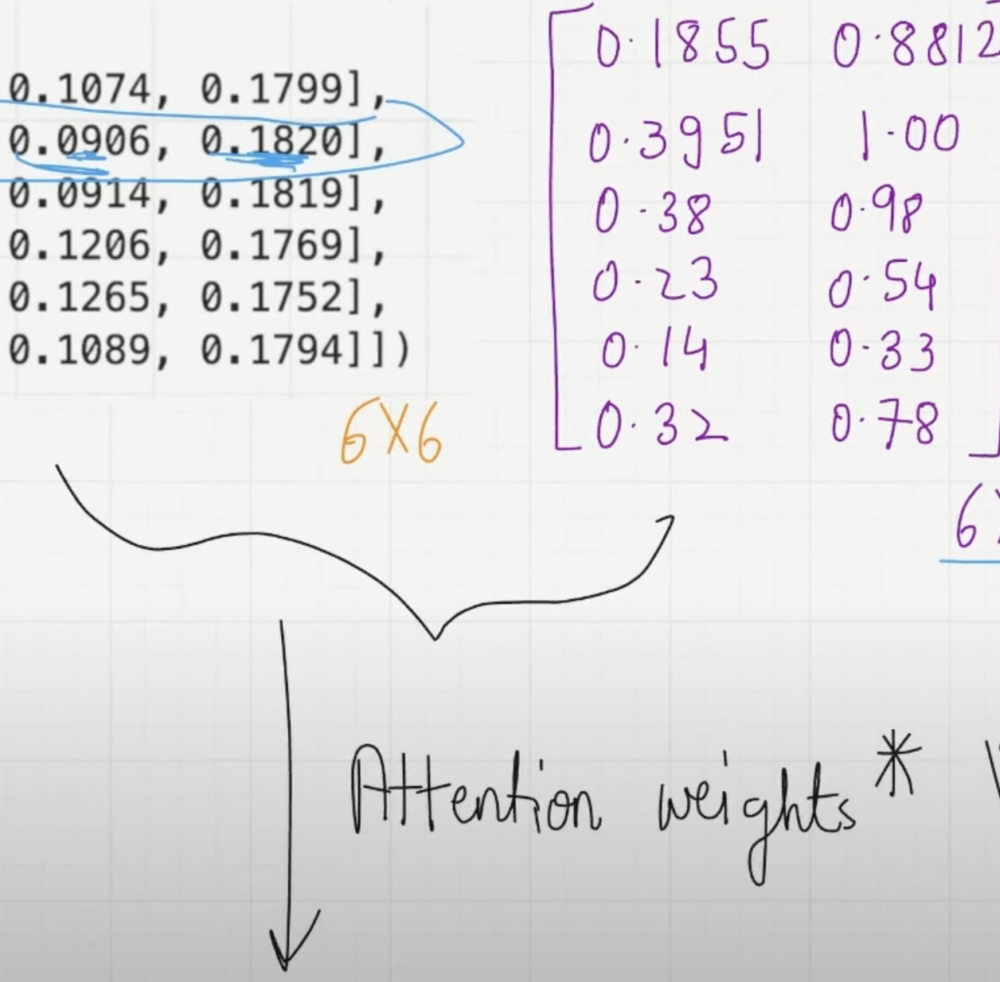

Attention weight ile valu matrisi çarpı bize context vektörü verir

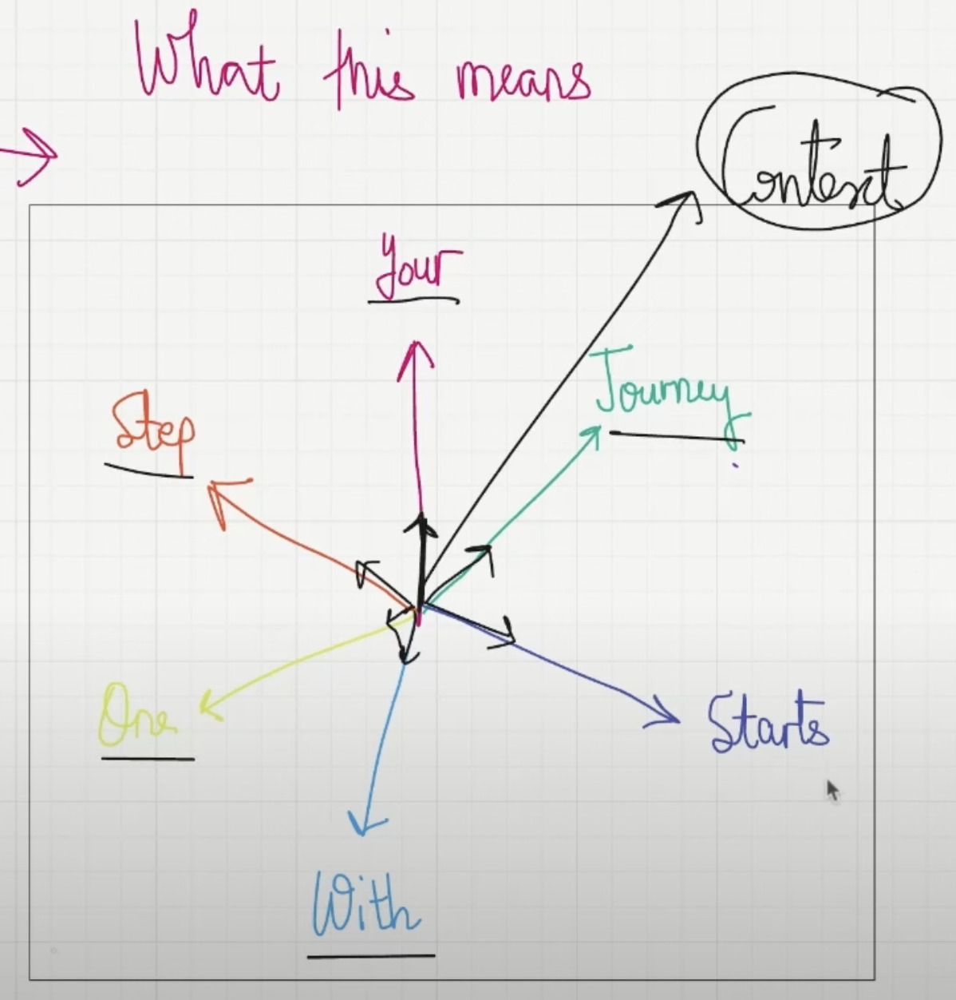

Basitce izlediğimiz adımlar;

1) Giriş embeddinglerini key, query ve value vektörlerine dönüştürme.
2) Key ve quey'i çarparak attention skoru hesaplama.
3) Ölçeklendirme ve softmax uygulayarak attention ağırlıklarını hesaplıyoruz.
4) Son olarak attention ağırlıklarıyla value değerlerini çarpıp context vektörünü elde ediyoruz.

Aşağıdaki görselle tüm bu süreci özetleyebiliriz:

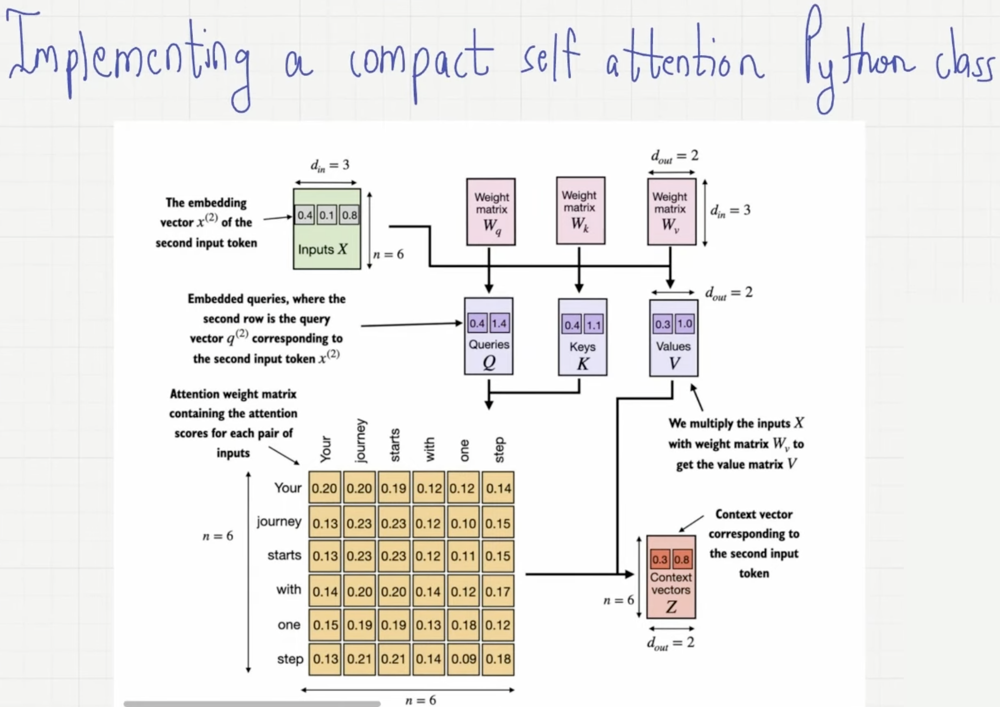

Peki neden bu terimleri kullanıyoruz, anlamı ne?

**Key:** Attention mekanizmasında, girdi dizisindeki her bir öğenin bir key'i vardır. Key'ler sorguyla eşleşmek için kullanılır.

**Query:** Bir veritabanındaki arama sorgusuna benzer: Modun odaklandığı geçerli belirteci temsil eder.

**Value:** Giriş öğelerinin gerçek içeriğini veya temsilini temsil eder. Mod, hangi Key'in hangi girdi bölümünün Query için daha alakalı olduğunu belirlediğinde (odak öğesi değil, karşılık gelen değerleri alır)

<div class="alert alert-block alert-success">

Bir kaç değişken tanımlayarak başlayalım:

</div>

<div class="alert alert-block alert-info">
    
#A İkinci girdi elemanı

#B Giriş embedding boyutu, d=3

#C Çıkış embedding boyutu, d_out=2

</div>

In [21]:
x_2 = inputs[1] #A
d_in = inputs.shape[1] #B
d_out = 2 #C

<div class="alert alert-block alert-info">

GPT gibi modellerde giriş ve çıkış boyutu genellikle sabittir fakat biz bu örnekte öğrenme amaçlı basit tutuyoruz.

Bu nedenle farklı giriş (d_in=3) ve çıkış boyutları (d_out=2) tanımlıyoruz.

</div>

<div class="alert alert-block alert-success">

Şimdi üçtane ağırlık parametresi tanımlıyoruz -> Wq, Wk ve Wv

**Not:** Bunlar eğitilebilir parametrelerdir fakat biz şuan sadece anlamaya çalıştığımız için bu değerlere random değerler atayacağız.

</div>

In [22]:
torch.manual_seed(123)
W_query = torch.nn.Parameter(torch.rand(d_in, d_out), requires_grad=False)
W_key = torch.nn.Parameter(torch.rand(d_in, d_out), requires_grad=False)
W_value = torch.nn.Parameter(torch.rand(d_in, d_out), requires_grad=False)

<div class="alert alert-block alert-info">

Öğrenme amacıyla çıktılardaki karmaşıyı azaltmak içim requires_grad'i false olarak tanımlıyoruz.

Ağırlık matrislerini model eğitimi için kullanacak olsaydık,
model eğitimi sırasında bu matrisleri güncellemek için requires_grad=True ayarını yapardık.

</div>

<div class="alert alert-block alert-success">

Şimdi, daha önce gösterdiğimiz query, key ve valu vektörlerini hesaplayacağız.

</div>

In [23]:
query_2 = x_2 @ W_query
key_2 = x_2 @ W_key
value_2 = x_2 @ W_value
print(query_2)

tensor([0.4306, 1.4551])


<div class="alert alert-block alert-info">

Sorgu çıktısına göre görebileceğimiz gibi, bu 2 boyutlu bir vektörle sonuçlanır.

Bunun nedeni: d_out aracılığıyla karşılık gelen ağırlık matrisinin sütun sayısını 2 olarak ayarlamamızdır:

</div>

<div class="alert alert-block alert-success">

Geçici hedefimiz yalnızca bir bağlam vektörü z(2)'yi hesaplamak olsa da, yine de tüm girdi öğeleri için key ve value vektörlerine ihtiyacımız var.

Bunun nedeni, bunların sorgu q(2) ile ilgili dikkat ağırlıklarının hesaplanmasında yer almasıdır

</div>

<div class="alert alert-block alert-success">

Tüm key ve value değerlerini matris çarpımıyla elde edebiliriz:

</div>

In [24]:
keys = inputs @ W_key
values = inputs @ W_value
print("keys.shape:", keys.shape)
print("values.shape:", values.shape)

keys.shape: torch.Size([7, 2])
values.shape: torch.Size([7, 2])


<div class="alert alert-block alert-info">
    
Çıktılardan da anlaşılacağı üzere, 6 giriş tokenini 3B'den 2B embedding alanına başarıyla yansıttık:

</div>

<div class="alert alert-block alert-success">

İlk olarak w22 attention skorunu hesaplayalım. </div>

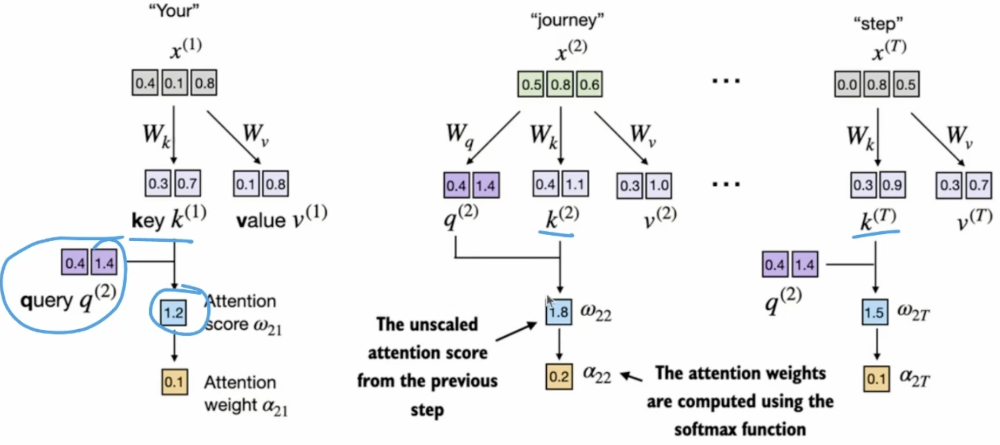

In [25]:
keys_2 = keys[1] #A
attn_score_22 = query_2.dot(keys_2)
print(attn_score_22)

tensor(1.8524)


<div class="alert alert-block alert-success">
Yine bu hesaplamayı matris çarpımı yoluyla tüm attention puanlarına genelleştirebiliriz:
</div>

In [52]:
attn_scores_2 = query_2 @ keys.T # Verilen dizi için tüm attention scorlarını hesaplama
print(attn_scores_2)

tensor([-0.4489, -0.6616, -0.6274, -0.4417,  0.1643, -0.7930, -0.5283],
       grad_fn=<SqueezeBackward4>)


<div class="alert alert-block alert-success">
    
Attention weight'lerini, attention skorlarına ölçeklendirerek ve daha önce kullandığımız softmax fonksiyonunu kullanarak hesaplıyoruz.

Daha öncekinden farkı, şimdi attention skorlarını tokenların embedding boyutunun kareköküne bölerek ölçeklendiriyoruz.

Karekök almanın matematiksel olarak 0,5'e üs almayla aynı şey olduğunu unutmayın:

</div>

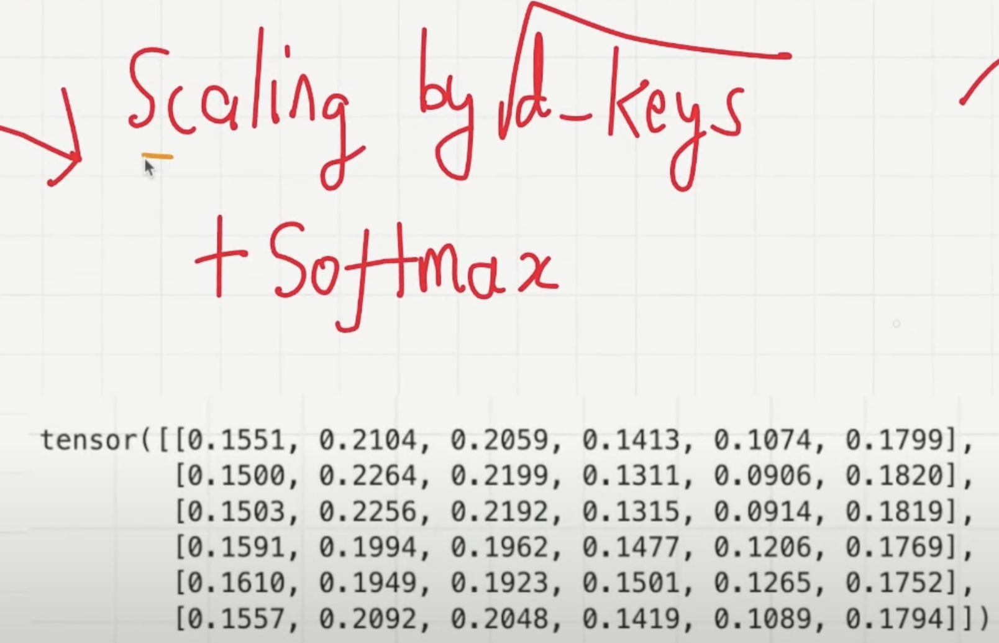

In [27]:
d_k = keys.shape[-1]
attn_weights_2 = torch.softmax(attn_scores_2 / d_k**0.5, dim=-1)
print(attn_weights_2)

tensor([0.1278, 0.1929, 0.1873, 0.1117, 0.0772, 0.1551, 0.1480])


<div class="alert alert-block alert-success">
    
Şimdi bağlam vektörünü value vektörleri üzerinden ağırlıklı bir toplam olarak hesaplıyoruz.

Burada, attention weight'leri her value vektörünün ilgili önemini tartan bir ağırlıklandırma faktörü olarak hizmet eder.

Çıktıyı tek adımda elde etmek için matris çarpımını kullanabiliriz:

</div>

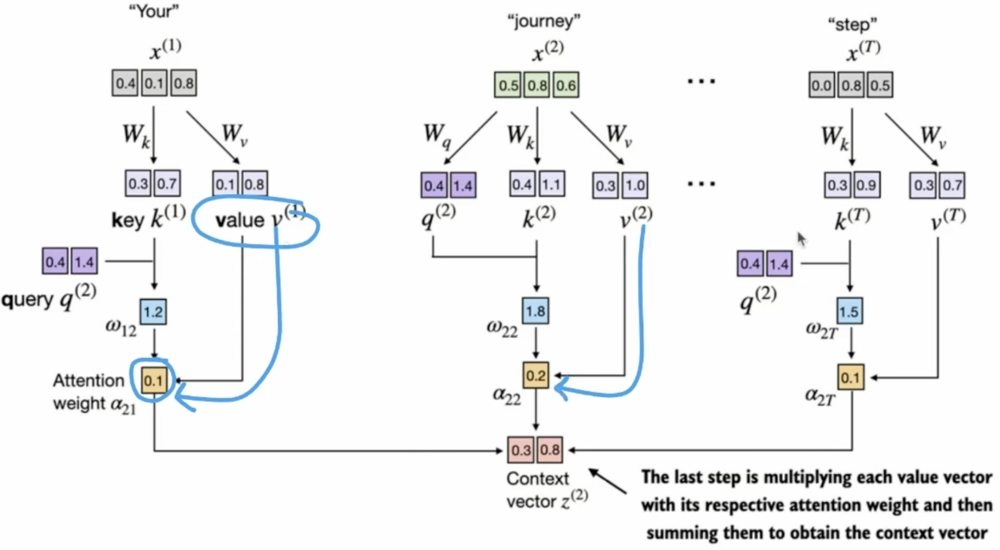

In [28]:
context_vec_2 = attn_weights_2 @ values
print(context_vec_2)

tensor([0.3062, 0.8207])


<div class="alert alert-block alert-success">
    
Şimdiye kadar sadece tek bir context vektörü, z(2) hesapladık.

Bir sonraki bölümde, giriş dizisindeki tüm context vektörlerini, z(1)'den z(T)'ye kadar hesaplamak için kodu genelleştireceğiz.</div>

## KARMAŞIK BİR PYTHON SELF ATTENTİON SINIFININ UYGULANMASI

<div class="alert alert-block alert-success">
    
Önceki bölümlerde, self-attention çıktılarını hesaplamak için birçok adımdan geçtik.

Bu, esas olarak açıklama amaçlı yapıldı, böylece bir seferde bir adım
geçebildik.

Uygulamada, bir sonraki bölümdeki LLM uygulamasını akılda tutarak, bu kodu aşağıdaki gibi bir Python class'ı şeklinde düzenlemek faydalıdır:
    
</div>

In [29]:
import torch.nn as nn

class SelfAttention_v1(nn.Module):

    def __init__(self, d_in, d_out):
        super().__init__()
        self.W_query = nn.Parameter(torch.rand(d_in, d_out))
        self.W_key   = nn.Parameter(torch.rand(d_in, d_out))
        self.W_value = nn.Parameter(torch.rand(d_in, d_out))

    def forward(self, x):
        keys = x @ self.W_key
        queries = x @ self.W_query
        values = x @ self.W_value
        
        attn_scores = queries @ keys.T # omega
        attn_weights = torch.softmax(
            attn_scores / keys.shape[-1]**0.5, dim=-1
        )

        context_vec = attn_weights @ values
        return context_vec

<div class="alert alert-block alert-warning">

Bu PyTorch kodunda, SelfAttention_v1, PyTorch modellerinin temel yapı taşı olan nn.Module'den türetilen bir sınıftır ve model katmanı oluşturma ve yönetimi için gerekli işlevleri sağlar.
</div>

<div class="alert alert-block alert-warning">

__init__ yöntemi, query, key ve value için eğitilebilir ağırlık matrislerini (W_query, W_key ve
W_value) başlatır ve her biri giriş boyutu d_in'i bir
çıktı boyutu d_out'a dönüştürür.

</div>

<div class="alert alert-block alert-warning">

Forward sırasında, forward methodu kullanarak, query ve key çarparak attention puanlarını (attn_scores) hesaplarız, bu puanları softmax kullanarak normalleştiririz.

</div>

<div class="alert alert-block alert-success">
    
Son olarak, bu normalleştirilmiş attention skorları değerlerini valu değerleriyle çarparak bir context vektörü oluşturuyoruz.
    
</div>

In [53]:
torch.manual_seed(123)
sa_v1 = SelfAttention_v1(d_in, d_out)
print(sa_v1(inputs))

tensor([[0.3007, 0.8073],
        [0.3062, 0.8207],
        [0.3060, 0.8201],
        [0.2966, 0.7975],
        [0.2948, 0.7934],
        [0.3002, 0.8062],
        [0.3021, 0.8109]], grad_fn=<MmBackward0>)


<div class="alert alert-block alert-info">

Girişler altı embedding vektörü içerdiğinden, yukarıdaki sonuçta gösterildiği gibi altı context vektörünü depolayan bir matris elde ederiz.

</div>

<div class="alert alert-block alert-info">

Hızlı bir kontrol olarak, ikinci satırın ([0.3061, 0.8210]) önceki bölümdeki
context_vec_2 içeriğiyle nasıl eşleştiğine dikkat edin.
    
</div>

<div class="alert alert-block alert-warning">

PyTorch'un nn.Linear katmanlarını kullanarak SelfAttention_v1 uygulamasını daha da geliştirebiliriz; bu katmanlar önyargı (bias) birimleri devre dışı bırakıldığında matris çarpımını etkili bir şekilde gerçekleştirir.

</div>

<div class="alert alert-block alert-warning">

Ek olarak, nn.Parameter(torch.rand(...))'i manuel olarak uygulamak yerine nn.Linear'ı kullanmanın önemli bir avantajı, nn.Linear'ın optimize edilmiş bir ağırlık
başlatma şemasına sahip olması ve daha kararlı ve etkili model eğitimine katkıda bulunmasıdır.

</div>

In [31]:
class SelfAttention_v2(nn.Module):

    def __init__(self, d_in, d_out, qkv_bias=False):
        super().__init__()
        self.W_query = nn.Linear(d_in, d_out, bias=qkv_bias)
        self.W_key   = nn.Linear(d_in, d_out, bias=qkv_bias)
        self.W_value = nn.Linear(d_in, d_out, bias=qkv_bias)

    def forward(self, x):
        keys = self.W_key(x)
        queries = self.W_query(x)
        values = self.W_value(x)
        
        attn_scores = queries @ keys.T
        attn_weights = torch.softmax(attn_scores / keys.shape[-1]**0.5, dim=-1)

        context_vec = attn_weights @ values
        return context_vec

<div class="alert alert-block alert-success">

SelfAttention_v1'e benzer şekilde SelfAttention_v2'yi kullanabilirsiniz:
    
</div>

In [32]:
torch.manual_seed(789)
sa_v2 = SelfAttention_v2(d_in, d_out)
print(sa_v2(inputs))

tensor([[-0.0765,  0.0694],
        [-0.0773,  0.0685],
        [-0.0773,  0.0685],
        [-0.0783,  0.0669],
        [-0.0786,  0.0665],
        [-0.0778,  0.0677],
        [-0.0775,  0.0681]], grad_fn=<MmBackward0>)


<div class="alert alert-block alert-info">

SelfAttention_v1 ve SelfAttention_v2'nin farklı çıktılar verdiğini unutmayın çünkü nn.Linear daha
karmaşık bir ağırlık başlatma şeması kullandığından ağırlık matrisleri için farklı başlangıç ​​ağırlıkları kullanırlar.
    
</div>

## GELECEK KELİMELERİNİ CASUAL ATTENTION (MASKED ATTENTION) İLE GİZLEME

Herhangi bir veriyi işlerken, modeli yalnızca bir dizideki önceki ve geçerli girdileri dikkate alacak şekilde kısıtlar. Bu, tüm giriş dizisine aynı anda erişim sağlayan self-attention mekanizmasının tersidir.

Attention skorları hesaplanırken, Casual Attention mekanizması, modelin yalnızca dizideki geçerli tokendan önce veya aynı anda ortaya çıkan tokenın hesaba katmasını sağlar.

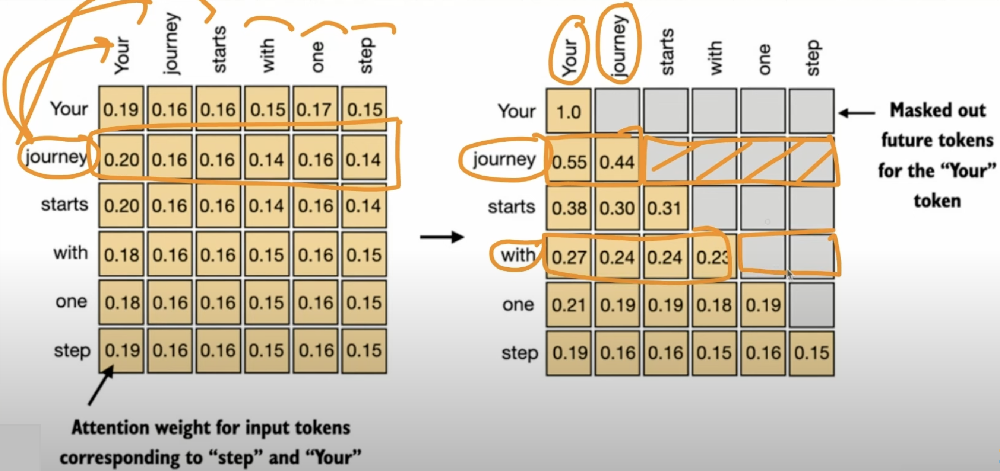

Genel algoritma:

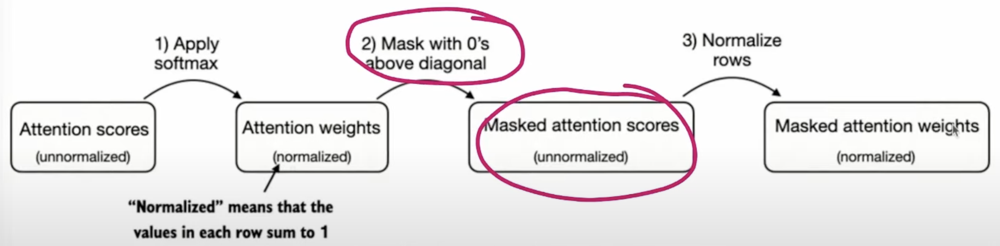

<div class="alert alert-block alert-success">

Casual attention mekanizmasını kodlamak için önceki bölümdeki attenition skorlarını ve ağırlıklarıyla çalışalım.
    
</div>

<div class="alert alert-block alert-success">

Önceki bölümlerde yaptığımız gibi softmax fonksiyonunu kullanarak attention ağırlıklarını hesaplıyoruz:

</div>


<div class="alert alert-block alert-info">

Önceki bölümden SelfAttention_v2 nesnesinin query ve key ağırlık matrislerini kolaylık olması açısından yeniden kullanalım.
    
</div>

In [54]:
queries = sa_v2.W_query(inputs) #A
keys = sa_v2.W_key(inputs)
attn_scores = queries @ keys.T
attn_weights = torch.softmax(attn_scores / keys.shape[-1]**0.5, dim=1)
print(attn_weights)

tensor([[0.1648, 0.1413, 0.1417, 0.1330, 0.1477, 0.1295, 0.1421],
        [0.1751, 0.1423, 0.1426, 0.1283, 0.1428, 0.1268, 0.1421],
        [0.1746, 0.1423, 0.1426, 0.1285, 0.1428, 0.1270, 0.1421],
        [0.1602, 0.1429, 0.1430, 0.1347, 0.1424, 0.1341, 0.1427],
        [0.1569, 0.1430, 0.1431, 0.1362, 0.1422, 0.1359, 0.1428],
        [0.1659, 0.1426, 0.1428, 0.1322, 0.1428, 0.1311, 0.1425],
        [0.1682, 0.1424, 0.1427, 0.1313, 0.1434, 0.1298, 0.1423]],
       grad_fn=<SoftmaxBackward0>)


<div class="alert alert-block alert-success">

Artık PyTorch'un tril fonksiyonunu kullanarak diyagonalin üstündeki değerlerin sıfır olduğu bir maske oluşturabiliriz:

</div>

In [34]:
context_length = attn_scores.shape[0]
mask_simple = torch.tril(torch.ones(context_length, context_length))
print(mask_simple)

tensor([[1., 0., 0., 0., 0., 0., 0.],
        [1., 1., 0., 0., 0., 0., 0.],
        [1., 1., 1., 0., 0., 0., 0.],
        [1., 1., 1., 1., 0., 0., 0.],
        [1., 1., 1., 1., 1., 0., 0.],
        [1., 1., 1., 1., 1., 1., 0.],
        [1., 1., 1., 1., 1., 1., 1.]])


<div class="alert alert-block alert-success">

Şimdi, bu maskeyi dikkat ağırlıklarıyla çarparak diyagonalin üstündeki değerleri sıfırlayabiliriz:

</div>

In [35]:
masked_simple = attn_weights*mask_simple
print(masked_simple)

tensor([[0.1648, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
        [0.1751, 0.1423, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
        [0.1746, 0.1423, 0.1426, 0.0000, 0.0000, 0.0000, 0.0000],
        [0.1602, 0.1429, 0.1430, 0.1347, 0.0000, 0.0000, 0.0000],
        [0.1569, 0.1430, 0.1431, 0.1362, 0.1422, 0.0000, 0.0000],
        [0.1659, 0.1426, 0.1428, 0.1322, 0.1428, 0.1311, 0.0000],
        [0.1682, 0.1424, 0.1427, 0.1313, 0.1434, 0.1298, 0.1423]],
       grad_fn=<MulBackward0>)


<div class="alert alert-block alert-info">

Gördüğümüz gibi, köşegenin üstündeki elemanlar başarıyla sıfırlandı
    
</div>

<div class="alert alert-block alert-success">

Üçüncü adım, attention ağırlıklarını her satırda tekrar 1'e toplayacak şekilde yeniden normalleştirmektir.

Bunu, her satırdaki her elemanı her satırdaki toplama bölerek başarabiliriz:

</div>

In [55]:
row_sums = masked_simple.sum(dim=1, keepdim=True)
masked_simple_norm = masked_simple / row_sums
print(masked_simple_norm)

tensor([[1.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
        [0.5517, 0.4483, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
        [0.3800, 0.3097, 0.3103, 0.0000, 0.0000, 0.0000, 0.0000],
        [0.2758, 0.2460, 0.2462, 0.2319, 0.0000, 0.0000, 0.0000],
        [0.2175, 0.1983, 0.1984, 0.1888, 0.1971, 0.0000, 0.0000],
        [0.1935, 0.1663, 0.1666, 0.1542, 0.1666, 0.1529, 0.0000],
        [0.1682, 0.1424, 0.1427, 0.1313, 0.1434, 0.1298, 0.1423]],
       grad_fn=<DivBackward0>)


<div class="alert alert-block alert-info">

Sonuç, diyagonalin üstündeki attention ağırlıklarının sıfırlandığı ve satırların toplamının 1 olduğu bir attention ağırlık matrisidir.

</div>

<div class="alert alert-block alert-success">

Bu noktada teknik olarak casual attention uygulama işini bitirmiş olsak da, softmax fonksiyonunun matematiksel bir özelliğinden faydalanabiliriz.

Maskelenmiş dikkat ağırlıklarının hesaplanmasını daha az adımda daha verimli bir şekilde uygulayabiliriz.

</div>

<div class="alert alert-block alert-success">

Softmax fonksiyonu girdilerini bir olasılık dağılımına dönüştürür.

Bir satırda negatif
sonsuzluk değerleri (-∞) mevcut olduğunda, softmax fonksiyonu bunları sıfır
olasılık olarak ele alır.

(Matematiksel olarak, bunun nedeni e
-∞'nin 0'a
yaklaşmasıdır.)

Bu daha verimli maskeleme "trick" köşegenin üstünde 1'ler olan bir maske oluşturarak ve sonra bu 1'leri negatif sonsuzluk (-inf) değerleriyle değiştirerek uygulayabiliriz:

</div>

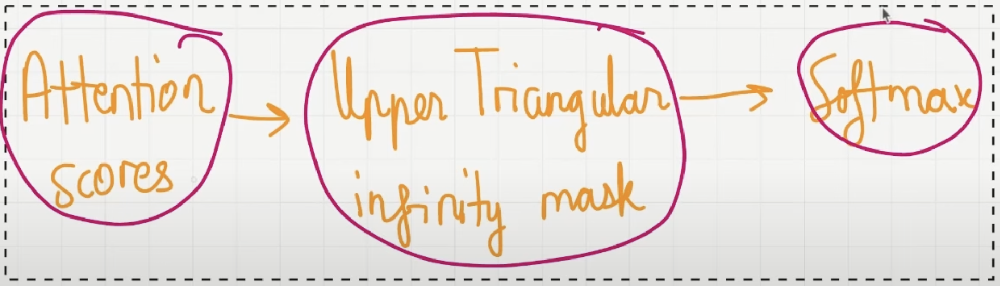

In [36]:
mask = torch.triu(torch.ones(context_length, context_length), diagonal=1)
masked = attn_scores.masked_fill(mask.bool(), -torch.inf)
print(masked)

tensor([[0.2899,   -inf,   -inf,   -inf,   -inf,   -inf,   -inf],
        [0.4656, 0.1723,   -inf,   -inf,   -inf,   -inf,   -inf],
        [0.4594, 0.1703, 0.1731,   -inf,   -inf,   -inf,   -inf],
        [0.2642, 0.1024, 0.1036, 0.0186,   -inf,   -inf,   -inf],
        [0.2183, 0.0874, 0.0882, 0.0177, 0.0786,   -inf,   -inf],
        [0.3408, 0.1270, 0.1290, 0.0198, 0.1290, 0.0078,   -inf],
        [0.3684, 0.1329, 0.1354, 0.0177, 0.1424, 0.0013, 0.1320]],
       grad_fn=<MaskedFillBackward0>)


<div class="alert alert-block alert-success">

Şimdi yapmamız gereken tek şey softmax fonksiyonunu bu maskelenmiş sonuçlara uygulamak ve tamam olacağız.

</div>

In [37]:
attn_weights = torch.softmax(masked / keys.shape[-1]**0.5, dim=1)
print(attn_weights)

tensor([[1.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
        [0.5517, 0.4483, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
        [0.3800, 0.3097, 0.3103, 0.0000, 0.0000, 0.0000, 0.0000],
        [0.2758, 0.2460, 0.2462, 0.2319, 0.0000, 0.0000, 0.0000],
        [0.2175, 0.1983, 0.1984, 0.1888, 0.1971, 0.0000, 0.0000],
        [0.1935, 0.1663, 0.1666, 0.1542, 0.1666, 0.1529, 0.0000],
        [0.1682, 0.1424, 0.1427, 0.1313, 0.1434, 0.1298, 0.1423]],
       grad_fn=<SoftmaxBackward0>)


<div class="alert alert-block alert-info">

Çıktıya göre görebileceğimiz gibi, her satırdaki değerler 1'e eşit ve başka bir normalizasyona gerek yok.

</div>

<div class="alert alert-block alert-warning">

Transformers'daki maskeleme, gelecekteki token'lar için puanları büyük bir negatif değere ayarlar ve softmax hesaplamasındaki etkilerini etkili bir şekilde sıfırlar.

Softmax işlevi daha sonra yalnızca maskelenmemiş token'lar arasında dikkat ağırlıklarını yeniden hesaplar.

Bu süreç, maskelenmiş token'lardan bilgi sızıntısı olmamasını sağlayarak modeli yalnızca amaçlanan verilere odaklar.

</div>

<div class="alert alert-block alert-warning">

Şimdi değiştirilmiş attention ağırlıklarını context vektörlerini hesaplamak için kullanabiliriz

context_vec = attn_weights @ values.

Ancak, bir sonraki bölümde,
öncelikle LLM'leri eğitirken aşırı uyumu azaltmak için yararlı olan causal attention mekanizmasında başka bir küçük ayarlamayı ele alacağız.

</div>

### DROPOUT İLE EK ATTENTION AĞIRLIKLARINI GİZLEME

Dropout attention mekanizmasında iki spesifik alanda uygulanır.

1) Attention scorunu hesapladıktan sonra (yaygın olan ve GPT'nin kullandığı).
2) Attention ağırlıklarını value vektörleriyle çarptıktan sonra.

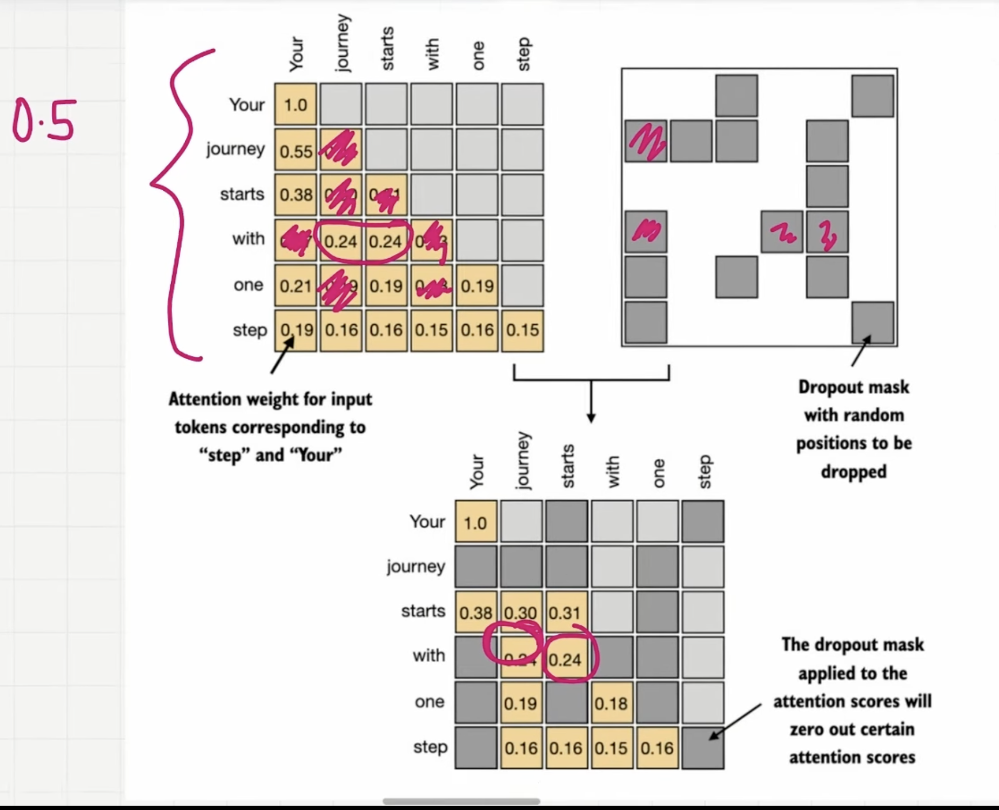

<div class="alert alert-block alert-success">

Aşağıdaki kod örneğinde, %50'lik bir dropout oranı kullanıyoruz, bu da dikkat ağırlıklarının yarısının maskelenmesi anlamına geliyor.

GPT modelini sonraki bölümlerde eğittiğimizde, 0,1 veya 0,2 gibi daha düşük bir dropout oranı kullanacağız.
</div>

<div class="alert alert-block alert-success">

Aşağıdaki kodda, PyTorch'un dropout uygulamasını ilk önce örnek amaçlı olarak birlerden oluşan 6×6'lık bir tensöre uyguluyoruz:
</div>

In [56]:
torch.manual_seed(123)
dropout = torch.nn.Dropout(0.5) #A
example = torch.ones(6, 6) #B
print(dropout(example))

tensor([[2., 2., 0., 2., 2., 0.],
        [0., 0., 0., 2., 0., 2.],
        [2., 2., 2., 2., 0., 2.],
        [0., 2., 2., 0., 0., 2.],
        [0., 2., 0., 2., 0., 2.],
        [0., 2., 2., 2., 2., 0.]])


<div class="alert alert-block alert-info">

Attention ağırlık matrisine %50 oranında dropout uygulandığında, matristeki öğelerin yarısı rastgele sıfıra ayarlanır.

Aktif öğelerdeki azalmayı telafi etmek için, matristeki kalan öğelerin değerleri 1/0,5 = 2 faktörüyle ölçeklendirilir.

Bu ölçeklendirme, attention ağırlıklarının genel dengesini korumak ve dikkat mekanizmasının ortalama etkisinin hem eğitim hem de çıkarım aşamalarında tutarlı kalmasını sağlamak için çok önemlidir.

</div>

<div class="alert alert-block alert-success">

Şimdi dropout'u attention matrisine uygulayalım

</div>

In [57]:
torch.manual_seed(123)
print(dropout(attn_weights))

tensor([[0.3297, 0.2825, 0.0000, 0.2660, 0.2953, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.2852, 0.0000, 0.2856, 0.2535, 0.2842],
        [0.3493, 0.2847, 0.0000, 0.2570, 0.0000, 0.2540, 0.2842],
        [0.0000, 0.0000, 0.2861, 0.0000, 0.2848, 0.0000, 0.2853],
        [0.0000, 0.2861, 0.0000, 0.2723, 0.2843, 0.2717, 0.2855],
        [0.0000, 0.2853, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.2853, 0.0000, 0.2867, 0.2595, 0.0000]],
       grad_fn=<MulBackward0>)


<div class="alert alert-block alert-info">

Yukarıda görebileceğimiz gibi, ortaya çıkan dikkaattention ağırlık matrisinde artık ek öğeler sıfırlanmış ve kalanlar yeniden ölçeklendirilmiştir.
    
</div>

<div class="alert alert-block alert-warning">

Casual attention ve dropout maskelemesi hakkında bir anlayış kazandıktan sonra, aşağıdaki bölümde özlü bir Python sınıfı geliştireceğiz.

Bu sınıf, bu iki tekniğin etkili bir şekilde uygulanmasını kolaylaştırmak için tasarlanmıştır.

</div>

### KOMPAKT BİR CAUSAL ATTENTION SINIFININ OLUŞTURULMASI

<div class="alert alert-block alert-success">

Bu bölümde, causal attention ve dropout değişikliklerini 3.4. bölümde geliştirdiğimiz SelfAttention Python sınıfına dahil edeceğiz.

Bu sınıf daha sonra gelecek bölümde multi-head attention mekanizmasını geliştirmek için bir şablon görevi görecek.

</div>

<div class="alert alert-block alert-success">

Başlamadan önce, kodun birden fazla girdiden oluşan grupları işleyebildiğinden emin olmak gerekir.

Bu, CausalAttention sınıfının daha önce uyguladığımız dataloader tarafından üretilen
batch çıktıları desteklemesini sağlayacaktır.

</div>

<div class="alert alert-block alert-success">

Basitleştirmek adına, bu tür batch girdileri simüle etmek için giriş metni örneğini çoğaltalım:

</div>

<div class="alert alert-block alert-info">

Her biri 6 tokendan oluşan 2 giriş ve her tokenın embedding boyutu 3
    
</div>

In [41]:
batch = torch.stack((inputs, inputs), dim=0)
print(batch.shape) 

torch.Size([2, 7, 3])


<div class="alert alert-block alert-info">

Bu herbiri 6 tokenlı 2 giriş metninden oluşan 3D tensor ile sonuçlanır ve burada her token 3D bir embedding vektörüne sahiptir.
    
</div>

<div class="alert alert-block alert-success">

Aşağıdaki CausalAttention sınıfı, daha önce uyguladığımız SelfAttention sınıfına benzerdir, ancak şimdi aşağıdaki kodda vurgulandığı gibi dropout ve causal mask bileşenlerini ekledik.
    
</div>

<div class="alert alert-block alert-info">

Adım 1: Önceki SelfAttention_v1 sınıfıyla karşılaştırıldığında, bir dropout katmanı ekledik.

Adım 2: register_buffer çağrısı da yeni bir eklemedir (aşağıdaki metinde daha fazla bilgi verilmiştir).

Adım 3: 1 ve 2 boyutlarını, batch boyutu ilk konumda (0) tutarak aktarıyoruz.

Adım 4: PyTorch'ta, son alt çizgiye sahip işlemler yerinde gerçekleştirilir ve gereksiz bellek
kopyalarından kaçınılır

</div>

In [42]:
class CausalAttention(nn.Module):

    def __init__(self, d_in, d_out, context_length,
                 dropout, qkv_bias=False):
        super().__init__()
        self.d_out = d_out
        self.W_query = nn.Linear(d_in, d_out, bias=qkv_bias)
        self.W_key   = nn.Linear(d_in, d_out, bias=qkv_bias)
        self.W_value = nn.Linear(d_in, d_out, bias=qkv_bias)
        self.dropout = nn.Dropout(dropout) # New
        self.register_buffer('mask', torch.triu(torch.ones(context_length, context_length), diagonal=1)) # New

    def forward(self, x):
        b, num_tokens, d_in = x.shape # New batch dimension b
        keys = self.W_key(x)
        queries = self.W_query(x)
        values = self.W_value(x)

        attn_scores = queries @ keys.transpose(1, 2) # Changed transpose
        attn_scores.masked_fill_(  # New, _ ops are in-place
            self.mask.bool()[:num_tokens, :num_tokens], -torch.inf)  # `:num_tokens` to account for cases where the number of tokens in the batch is smaller than the supported context_size
        attn_weights = torch.softmax(
            attn_scores / keys.shape[-1]**0.5, dim=-1
        )
        attn_weights = self.dropout(attn_weights) # New

        context_vec = attn_weights @ values
        return context_vec

<div class="alert alert-block alert-warning">

PyTorch'ta register_buffer kullanımı tüm kullanım durumları için kesinlikle gerekli değildir ancak burada birkaç avantaj sunar.

Örneğin, LLM'mizde CausalAttention sınıfını kullandığımızda, tamponlar otomatik olarak
modelimizle birlikte uygun cihaza (CPU veya GPU) taşınır ve bu da LLM'yi gelecekteki bölümlerde eğitirken önemli olacaktır.

Bu, bu tensörlerin model parametrelerinizle aynı cihazda olduğundan manuel olarak emin olmamız gerekmediği ve cihaz uyumsuzluğu hatalarından kaçındığımız anlamına gelir.

</div>

<div class="alert alert-block alert-success">

CasualAttention sınıfını daha önce SelfAttention sınıfını kullandığımuz gibi aşağıdaki gibi kullanabiliriz.
    
</div>

In [58]:
torch.manual_seed(123)
context_length = batch.shape[1]
ca = CausalAttention(d_in, d_out, context_length, 0.0)
context_vecs = ca(batch)
print("context_vecs.shape:", context_vecs.shape)

context_vecs.shape: torch.Size([2, 7, 2])


<div class="alert alert-block alert-info">

Gördüğümüz gibi, ortaya çıkan context vektörü her bir tokenın artık 2D
embedding ile temsil edildiği bir 3D tensördür:
    
</div>

<div class="alert alert-block alert-warning">

Bir sonraki bölümde bu kavramı genişleteceğiz ve bu tür casual attention mekanizmalarından birkaçını paralel olarak uygulayan multi-head attentiın modülü uygulayacağız.

</div>

## SINGLE-HEAD ATTENTION'NIN MULTI-HEAD ATTENTION'A GENİŞLETİLMESİ

Multiple-head her operasyonun bağımsız olarak gerçekleşmesi anlamına gelir. Yani self-attention mekanizmasından bir çok instance oluşturacağız ve her biri kendi ağırlığına sahip olacak. Son olarakta çıktılarını birleştireceğiz.

Bu süreç hesaplama çaısından yoğun olabilir ama karmaşık paternlerde LLM'leri daha güçlü yapar.

<div class="alert alert-block alert-success">

Pratik açıdan, multi-head  uygulamak, her biri kendi ağırlığına sahip olan, self-attention dikkat mekanizmasının birden fazla örneğini oluşturmayı ve ardından bunların çıktılarını birleştirmeyi içerir.
    
</div>

<div class="alert alert-block alert-success">

Kodda, daha önce uyguladığımız CausalAttention modülünün birden fazla örneğini yığınlayan basit bir MultiHeadAttentionWrapper sınıfı uygulayarak bunu başarabiliriz:
    
</div>

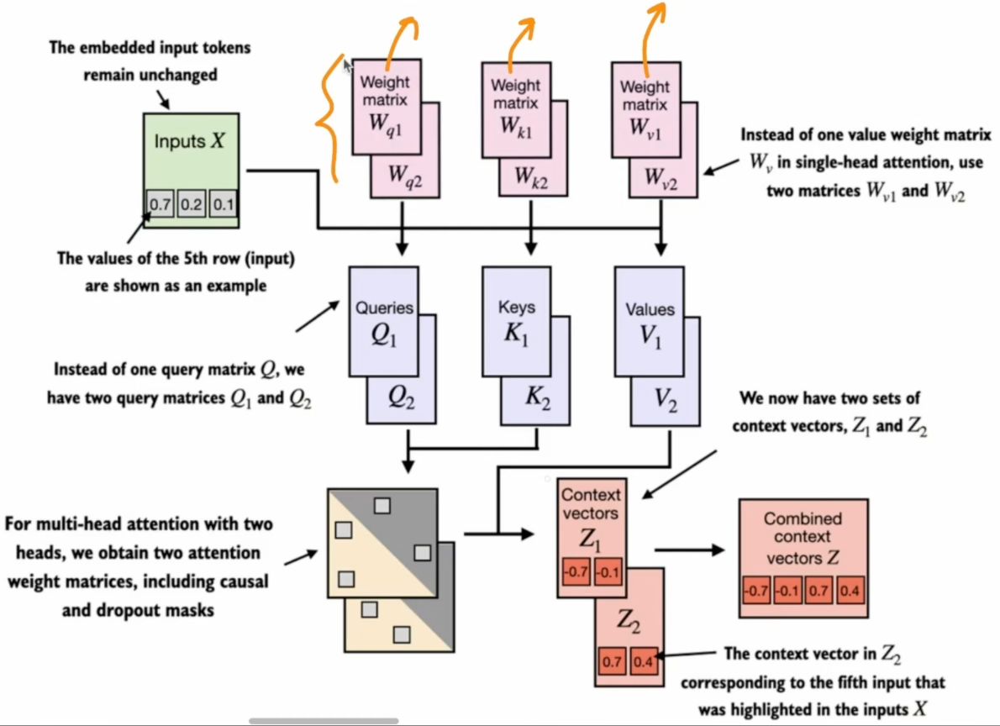
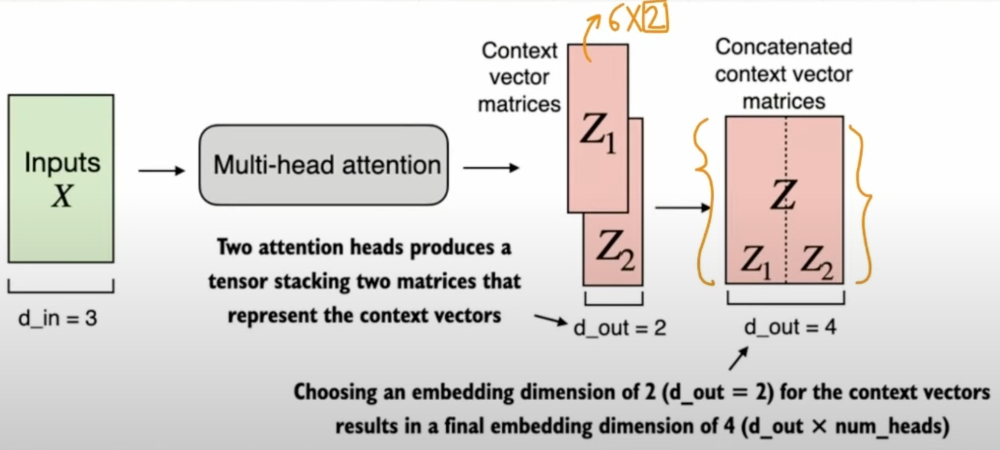

In [44]:
class MultiHeadAttentionWrapper(nn.Module):

    def __init__(self, d_in, d_out, context_length, dropout, num_heads, qkv_bias=False):
        super().__init__()
        self.heads = nn.ModuleList(
            [CausalAttention(d_in, d_out, context_length, dropout, qkv_bias) 
             for _ in range(num_heads)]
        )

    def forward(self, x):
        return torch.cat([head(x) for head in self.heads], dim=-1)


<div class="alert alert-block alert-info">

Örneğin, bu MultiHeadAttentionWrapper sınıfını iki attention head (via
num_heads=2) ve CausalAttention çıktı boyutu d_out=2 ile kullanırsak, bu 4 boyutlu bir context vektörüyle sonuçlanır (d_out*num_heads=4)
    
</div>

<div class="alert alert-block alert-success">
Daha somut bir örnekle açıklamak gerekirse, CausalAttention sınıfına benzer şekilde MultiHeadAttentionWrapper sınıfını kullanabiliriz:
</div>

In [45]:
torch.manual_seed(123)
context_length = batch.shape[1] # This is the number of tokens
d_in, d_out = 3, 2
mha = MultiHeadAttentionWrapper(d_in, d_out, context_length, 0.0, num_heads=2)
context_vecs = mha(batch)
print(context_vecs)
print("context_vecs.shape:", context_vecs.shape)

tensor([[[-0.4519,  0.2216,  0.4772,  0.1063],
         [-0.5874,  0.0058,  0.5891,  0.3257],
         [-0.6300, -0.0632,  0.6202,  0.3860],
         [-0.5675, -0.0843,  0.5478,  0.3589],
         [-0.5526, -0.0981,  0.5321,  0.3428],
         [-0.5299, -0.1081,  0.5077,  0.3493],
         [-0.5365, -0.1095,  0.5127,  0.3530]],

        [[-0.4519,  0.2216,  0.4772,  0.1063],
         [-0.5874,  0.0058,  0.5891,  0.3257],
         [-0.6300, -0.0632,  0.6202,  0.3860],
         [-0.5675, -0.0843,  0.5478,  0.3589],
         [-0.5526, -0.0981,  0.5321,  0.3428],
         [-0.5299, -0.1081,  0.5077,  0.3493],
         [-0.5365, -0.1095,  0.5127,  0.3530]]], grad_fn=<CatBackward0>)
context_vecs.shape: torch.Size([2, 7, 4])


<div class="alert alert-block alert-info">

Sonuçtaki context_vecs tensörünün ilk boyutu 2'dir çünkü iki giriş metnimiz var
(giriş metinleri çoğaltılmıştır, bu yüzden context vektörleri onlar için tam olarak aynıdır).

İkinci boyut her girdideki 6 tokenı ifade eder. Üçüncü boyut ise her tokenın 4 boyutlu embedding edilmesini ifade eder.
    
</div>

<div class="alert alert-block alert-success">
Bu bölümde, birden fazla single-head attention modülünü birleştiren bir MultiHeadAttentionWrapper uyguladık.

Ancak, bunların ileri yöntemde
[head(x) for head in self.heads] aracılığıyla ardışık olarak işlendiğini unutmayın.

Bu uygulamayı, head'leri paralel olarak işleyerek geliştirebiliriz.

Bunu başarmanın bir yolu,
bir sonraki bölümde inceleyeceğimiz gibi, tüm attention head'leri için için çıktıları matris çarpımı yoluyla aynı anda hesaplamaktır.
</div>

### AĞIRLIK BÖLÜMLERİYLE MULTI-HEAD ATTENTION UYGULAMA

<div class="alert alert-block alert-warning">
    
İki ayrı sınıf, MultiHeadAttentionWrapper ve
CausalAttention, tutmak yerine, bu kavramların ikisini de tek bir
MultiHeadAttention sınıfında birleştirebiliriz.

Ayrıca, sadece
MultiHeadAttentionWrapper'ı CausalAttention koduyla birleştirmenin yanı sıra, multi-head attention'ı daha verimli bir şekilde uygulamak için bazı başka
değişiklikler yapacağız.
</div>

<div class="alert alert-block alert-warning">
    
MultiHeadAttentionWrapper'da, her biri ayrı bir dikkat başlığını temsil eden CausalAttention nesnelerinin (self.heads) bir listesini oluşturarak birden fazla head uygulanır.

CausalAttention sınıfı attention mekanizmasını bağımsız olarak gerçekleştirir ve her head'den gelen sonuçlar birleştirilir.

Buna karşılık, aşağıdaki MultiHeadAttention
sınıfı, multi-head işlevselliği tek bir sınıf içinde bütünleştirir.

Girdiyi, yansıtılan que, key ve value tensörlerini yeniden şekillendirerek birden fazla head'e böler ve ardından attention'ı hesapladıktan sonra bu head'lerden gelen sonuçları birleştirir.
</div>

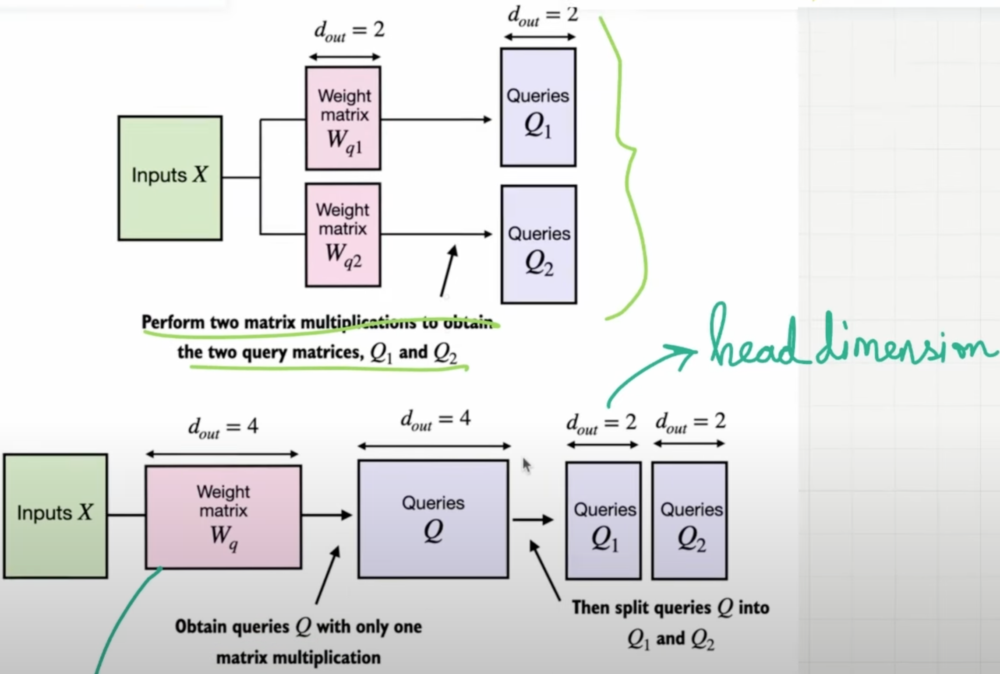

<div class="alert alert-block alert-success">

Daha fazla ayrıntıya girmeden önce MultiHeadAttention sınıfına bir göz atalım:
</div>

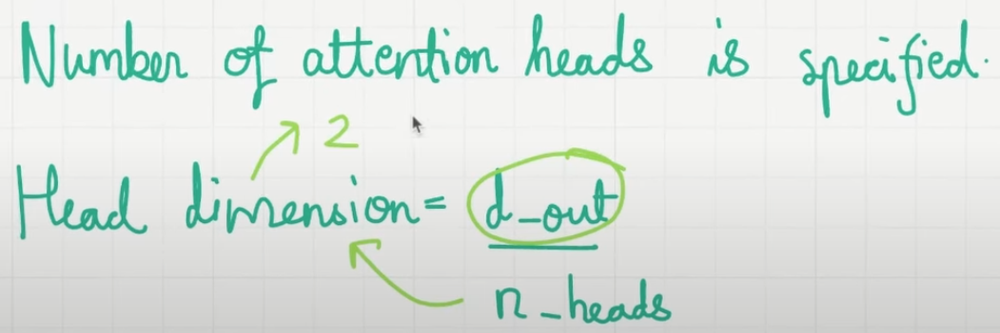

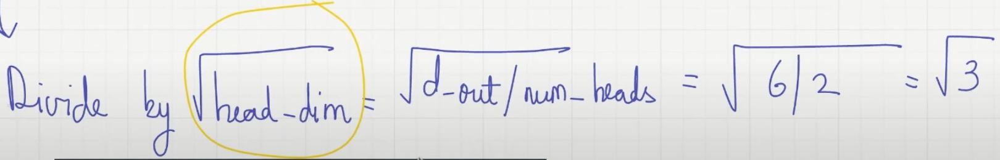

In [47]:
class MultiHeadAttention(nn.Module):
    def __init__(self, d_in, d_out, context_length, dropout, num_heads, qkv_bias=False):
        super().__init__()
        assert (d_out % num_heads == 0), \
            "d_out must be divisible by num_heads"

        self.d_out = d_out
        self.num_heads = num_heads
        self.head_dim = d_out // num_heads # İstenilen çıkış boyutuyla eşleşecek şekilde projeksiyon boyutunu azaltın

        self.W_query = nn.Linear(d_in, d_out, bias=qkv_bias)
        self.W_key = nn.Linear(d_in, d_out, bias=qkv_bias)
        self.W_value = nn.Linear(d_in, d_out, bias=qkv_bias)
        self.out_proj = nn.Linear(d_out, d_out)  # Head çıkışlarını birleştirmek için doğrusal katman
        self.dropout = nn.Dropout(dropout)
        self.register_buffer(
            "mask",
            torch.triu(torch.ones(context_length, context_length),
                       diagonal=1)
        )

    def forward(self, x):
        b, num_tokens, d_in = x.shape

        keys = self.W_key(x) # Shape: (b, num_tokens, d_out)
        queries = self.W_query(x)
        values = self.W_value(x)

        # Matrisi örtük olarak `num_heads` boyutunu ekleyerek böldük
        # Son boyut: (b, num_tokens, d_out) -> (b, num_tokens, num_heads, head_dim)
        keys = keys.view(b, num_tokens, self.num_heads, self.head_dim) 
        values = values.view(b, num_tokens, self.num_heads, self.head_dim)
        queries = queries.view(b, num_tokens, self.num_heads, self.head_dim)

        # Transpose: (b, num_tokens, num_heads, head_dim) -> (b, num_heads, num_tokens, head_dim)
        keys = keys.transpose(1, 2)
        queries = queries.transpose(1, 2)
        values = values.transpose(1, 2)

        # Causel bir maske ile ölçeklenmiş nokta çarpım attentionını (diğer adıyla öz dikkat) hesaplayın
        attn_scores = queries @ keys.transpose(2, 3)  # Her head için okta çarpım

        # Orijinal maske, token sayısına bölündü ve Boolean'a dönüştürüldü
        mask_bool = self.mask.bool()[:num_tokens, :num_tokens]

        # Attention skorlarını doldurmak için maskeyi kullan
        attn_scores.masked_fill_(mask_bool, -torch.inf)
        
        attn_weights = torch.softmax(attn_scores / keys.shape[-1]**0.5, dim=-1)
        attn_weights = self.dropout(attn_weights)

        # Boyut: (b, num_tokens, num_heads, head_dim)
        context_vec = (attn_weights @ values).transpose(1, 2) 
        
        # Head'leri birleştirelim -> self.d_out = self.num_heads * self.head_dim
        context_vec = context_vec.contiguous().view(b, num_tokens, self.d_out)
        context_vec = self.out_proj(context_vec) # optional projection

        return context_vec

<div class="alert alert-block alert-info">

Adım 1: İstenen çıktı dim'ine uyması için projeksiyon dim'ini azaltın

Adım 2: Head çıktılarını birleştirmek için Doğrusal bir katman kullanın

Adım 3: Tensör şekli: (b, num_tokens, d_out)

Adım 4: Matrisi örtük olarak `num_heads` boyutunu ekleyerek böleriz. Sonra son dim'i açıyoruz: (b,
num_tokens, d_out) -> (b, num_tokens, num_heads, head_dim)

Adım 5: (b, num_tokens, num_heads, head_dim) şeklinden (b, num_heads, num_tokens, head_dim) şekline transpoze et

Adım 6: Her bir head için nokta çarpımını hesapla

Adım 7: Maske, token sayısına göre kesilir

Adım 8: Attention skolarını doldurmak için maskeyi kullan

Adım 9: Tensör şekli: (b, num_tokens, n_heads, head_dim)

Adım 10: Head'leri birleştir, self.d_out = self.num_heads * self.head_dim

Adım 11: İsteğe bağlı doğrusal bir izdüşüm ekle
</div>

<div class="alert alert-block alert-warning">

MultiHeadAttention sınıfı içindeki tensörlerin yeniden şekillendirilmesi (.view) ve transpoze edilmesi (.transpose) matematiksel olarak çok karmaşık görünse de, MultiHeadAttention sınıfı daha önceki MultiHeadAttentionWrapper ile aynı konsepti uygular.

</div>

<div class="alert alert-block alert-warning">

Genel olarak bakıldığında, önceki MultiHeadAttentionWrapper'da, birden fazla single-head attention katmanını birleştirerek multi-head bir attention katmanı oluşturduk.

MultiHeadAttention sınıfı entegre bir yaklaşım benimsiyor.

Multi-head bir
katmanla başlıyor ve sonra bu katmanı dahili olarak ayrı atention başlıklarına bölüyor.

</div>

#### MULTI-HEAD ATTENTION SINIFININ DETAYLI AÇIKLAMASI

<div class="alert alert-block alert-success">

Quey, key ve value tensörlerinin bölünmesi, PyTorch'un .view ve .transpose yöntemlerini kullanarak tensör yeniden şekillendirme ve aktarma işlemleriyle elde edilir.

Giriş önce dönüştürülür (query, key ve value için doğrusal katmanlar aracılığıyla) ve ardından birden fazla başlığı temsil edecek şekilde yeniden şekillendirilir.

</div>

<div class="alert alert-block alert-success">
Temel işlem, d_out boyutunu num_heads ve head_dim olarak bölmektir, burada
head_dim = d_out / num_heads.

Bu bölme daha sonra .view yöntemi kullanılarak elde edilir: (b, num_tokens, d_out) boyutlarının bir
tensörü (b, num_tokens,
num_heads, head_dim) boyutuna yeniden şekillendirilir.
</div>

<div class="alert alert-block alert-success">
Daha sonra tensörler, num_heads boyutunu num_tokens boyutundan önce getirmek için transpoze edilir ve (b, num_heads, num_tokens, head_dim) şekli elde edilir.

Bu transpozisyon, quey, key ve value farklı başlıklar arasında doğru şekilde hizalamak ve toplu matris çarpımlarını verimli bir şekilde gerçekleştirmek için çok önemlidir.
</div>

<div class="alert alert-block alert-success">

Bu toplu matris çarpımını göstermek için, aşağıdaki örnek tensöre sahip olduğumuzu varsayalım:

</div>

In [59]:
a = torch.tensor([[[[0.2745, 0.6584, 0.2775, 0.8573], #A
[0.8993, 0.0390, 0.9268, 0.7388],
[0.7179, 0.7058, 0.9156, 0.4340]],
[[0.0772, 0.3565, 0.1479, 0.5331],
[0.4066, 0.2318, 0.4545, 0.9737],
[0.4606, 0.5159, 0.4220, 0.5786]]]])

<div class="alert alert-block alert-info">

Bu tensorün boyutu: (b, num_heads, num_tokens, head_dim) = (1, 2, 3, 4)
</div>

<div class="alert alert-block alert-success">

Şimdi, tensörün kendisi ile tensörün son iki boyutunu, num_tokens ve head_dim'i transpoze ettiğimiz bir görünümü arasında toplu bir matris çarpımı gerçekleştiriyoruz:

</div>

In [60]:
print(a @ a.transpose(2, 3))

tensor([[[[1.3208, 1.1631, 1.2879],
          [1.1631, 2.2150, 1.8424],
          [1.2879, 1.8424, 2.0402]],

         [[0.4391, 0.7003, 0.5903],
          [0.7003, 1.3737, 1.0620],
          [0.5903, 1.0620, 0.9912]]]])


<div class="alert alert-block alert-info">

Bu durumda, PyTorch'taki matris çarpımı uygulaması, matris çarpımının son 2 boyut (num_tokens, head_dim) arasında gerçekleştirilmesini ve ardından bireysel headler için tekrarlanmasını sağlamak için 4 boyutlu giriş tensörünü işler.

</div>

<div class="alert alert-block alert-success">

Örneğin, yukarıdaki head kafa için matris çarpımını ayrı ayrı hesaplamanın daha kompakt bir yolu haline gelir:

</div>

In [50]:
first_head = a[0, 0, :, :]
first_res = first_head @ first_head.T
print("First head:\n", first_res)
second_head = a[0, 1, :, :]
second_res = second_head @ second_head.T
print("\nSecond head:\n", second_res)

First head:
 tensor([[1.3208, 1.1631, 1.2879],
        [1.1631, 2.2150, 1.8424],
        [1.2879, 1.8424, 2.0402]])

Second head:
 tensor([[0.4391, 0.7003, 0.5903],
        [0.7003, 1.3737, 1.0620],
        [0.5903, 1.0620, 0.9912]])


<div class="alert alert-block alert-info">

Sonuçlar, daha önce toplu matris çarpımını print(a @ a.transpose(2, 3)) kullandığımızda elde ettiğimiz sonuçlarla tamamen aynıdır:

</div>

<div class="alert alert-block alert-warning">

MultiHeadAttention ile devam edersek, attention ağırlıklarını ve context vektörlerini hesapladıktan sonra, tüm headlerden gelen context vektörleri (b,
num_tokens, num_heads, head_dim) şekline geri aktarılır.

Bu vektörler daha sonra (b, num_tokens, d_out) şekline yeniden şekillendirilir (düzleştirilir), böylece tüm headlerden gelen çıktılar etkili bir şekilde birleştirilir

</div>

<div class="alert alert-block alert-warning">

Ek olarak, headleri birleştirdikten sonra MultiHeadAttention'a sözde bir çıktı projeksiyon katmanı (self.out_proj) ekledik; bu, CausalAttention sınıfında mevcut değildir.

Bu çıktı projeksiyon katmanı kesinlikle gerekli değildir, ancak birçok LLM mimarisinde yaygın olarak kullanılır; bu yüzden eksiksiz olması için buraya ekledik.

</div>

<div class="alert alert-block alert-warning">

MultiHeadAttention sınıfı, tensörlerin ek yeniden şekillendirilmesi ve transpozisyonu nedeniyle MultiHeadAttentionWrapper'dan daha karmaşık görünse de, daha verimlidir.

Bunun nedeni, tokenları hesaplamak için yalnızca bir matris çarpımına ihtiyaç duymamızdır, örneğin, keys = self.W_key(x) (quey ve value için de aynı şey geçerlidir).

MultiHeadAttentionWrapper'da, her attention head için bu matris çarpımını tekrarlamamız gerekiyordu, bu da hesaplama açısından en pahalı adımlardan biridir.

</div>

<div class="alert alert-block alert-success">
MultiHeadAttention sınıfı, daha önce uyguladığımız SelfAttention ve
CausalAttention sınıflarına benzer şekilde kullanılabilir:
</div>

In [61]:
torch.manual_seed(123)
batch_size, context_length, d_in = batch.shape
print(batch_size, context_length, d_in)
d_out = 2
mha = MultiHeadAttention(d_in, d_out, context_length, 0.0, num_heads=2)
context_vecs = mha(batch)
print(context_vecs)
print("context_vecs.shape:", context_vecs.shape)

2 7 3
tensor([[[0.3190, 0.4858],
         [0.2943, 0.3897],
         [0.2856, 0.3593],
         [0.2693, 0.3873],
         [0.2639, 0.3928],
         [0.2575, 0.4028],
         [0.2585, 0.3993]],

        [[0.3190, 0.4858],
         [0.2943, 0.3897],
         [0.2856, 0.3593],
         [0.2693, 0.3873],
         [0.2639, 0.3928],
         [0.2575, 0.4028],
         [0.2585, 0.3993]]], grad_fn=<ViewBackward0>)
context_vecs.shape: torch.Size([2, 7, 2])


<div class="alert alert-block alert-info">

Sonuçlara dayanarak görebileceğimiz gibi, çıktı boyutu doğrudan
d_out argümanı tarafından kontrol ediliyor:

</div>

<div class="alert alert-block alert-warning">

Bu bölümde, LLM'yi uygularken ve eğitirken gelecek bölümlerde kullanacağımız MultiHeadAttention sınıfını uyguladık.

Kod tamamen işlevsel olsa da, çıktıları okunabilir tutmak için nispeten küçük embedding boyutları ve attention
head sayıları kullandığımızı unutmayın.

</div>

<div class="alert alert-block alert-warning">

Karşılaştırma için, en küçük GPT-2 modeli (117 milyon parametre) 12 attention head'ine ve 768'lik bir context vektörü embedding boyutuna sahiptir.

En büyük GPT-2 modeli (1,5 milyar
parametre) 25 attention head ve 1600'lük bir context vektörü embedding boyutuna sahiptir.

GPT
modellerinde token girdilerinin ve context vektörü embedding boyutlarının aynı olduğunu unutmayın (d_in = d_out).

</div>